# Dog breed classification

## Aalto CS-E4890 - Deep Learning 2019
## Kaarlo Kekkonen
### https://github.com/kkekkonen/dog-classification

## 1. Introduction

This notebook is comparing different neural networks to determine if any of them is clearly superior, in a classification task. The classification in questio is Kaggle's Dog Breed Identification. The dataset contains 10222 labeled images of dogs, with 120 different dog breeds. The aim is to simply classify, which breed does a image of dog relate to.

In short, the project tries to determine the varying performance of different neural networks in image classification. I will create multiple models, train them and evaluate their results, finally comparing them.

The code and stdout parts are important part of the report. Peergrade does support jupyter notebooks, I don't get why this cannot be supported as an option.

In [1]:
%matplotlib inline
from PIL import Image
from pylab import rcParams
from skimage import io, transform
from sklearn.model_selection import train_test_split
from torch.autograd import Variable
from torch.optim import lr_scheduler
from torch.utils.data import Dataset, DataLoader
from torchvision import datasets, models, transforms

import datetime
import itertools
import matplotlib.pyplot as plt
import numpy as np
import os
import pandas as pd
import random
import seaborn as sns
import torch
import torch.nn as nn
import torch.nn.functional as F
import torch.optim as optim
import torchvision

In [2]:
# set the device here. This variable is required!
device = torch.device("cuda")

## 2. Data

The data given by the Kaggle competition is Stanfords Dogs dataset (http://vision.stanford.edu/aditya86/ImageNetDogs/). It is a set of images split in training and testing partitions. In total there are slighly over 20000 images in the dataset, of which half are in the training partition. I have placed the training dataset to 'data/train_images/' and testing dataset to 'data/test_images'

A csv containing labels for the training partition is also given, which is linked with the training images later. I wont have much use for the testing partition, I merely try it out on evaluation phase at the end of the report.

In this chapter I will be processing the given data to enable its use in the training process.

### Dataloader

I use simple dataloader to load the images. The dataloader-class is defined here. The dataloader combines the image paths and class-labels into a easy-to-use form.

In [4]:
class CSVData(Dataset):
    def __init__(self, label_df, classes, class_indexes, data_dir, transform):
        self.label = label_df
        self.data_dir = data_dir
        self.transform = transform
        self.classes = classes
        self.class_indexes = class_indexes

    def __len__(self):
        return len(self.label) - 1

    def __getitem__(self, idx):
        label = self.label.iloc[idx, 1]
        img_path = os.path.join(self.data_dir, self.label.iloc[idx, 0] + '.jpg')
        image = self.transform(Image.open(img_path).convert('RGB'))

        return image, self.class_indexes[label]

### Transform the data

The transforms are optimal transformations obtained from the kaggle competition.
First the images are resized to 224x224, and then they are normalized, with mean being [0.485, 0.456, 0.406] and std being [0.229, 0.224, 0.225]. All these transformations are expected by pre-trained pytorch models as stated in their documentation.
https://pytorch.org/docs/stable/torchvision/models.html

The images are also randomly flipped horizontally with chance of 50%, to more randomize the data available.

After image transformation is complete, the dataloaders are created. 15% of the data is marked for validation and rest for training.  The dataloaders use batch_size=16 to spare VRAM, though the vram usually peaked at around 4400Mb, roughly half of what I have available. shuffle=True means the dataloaders images are shuffled. num_workers is set to 0 since it always crashed if set to anything else.

In [20]:
data_transforms = {
    'train': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.RandomHorizontalFlip(),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
    'test': transforms.Compose([
        transforms.Resize((224, 224)),
        transforms.ToTensor(),
        transforms.Normalize([0.485, 0.456, 0.406], [0.229, 0.224, 0.225])
    ]),
}
labels = pd.read_csv('data/labels.csv')

classes = list(labels.breed.unique())
class_indexes = {classes[i]: i for i in range(0, len(classes))}
class_names = classes


train, evaluation = train_test_split(labels, test_size=0.15)
image_datasets = {'train': CSVData(train,
                                   classes,
                                   class_indexes,
                                   'data/train',
                                   data_transforms['train']),
                 'test': CSVData(evaluation,
                                 classes,
                                 class_indexes,
                                 'data/train',
                                 data_transforms['train'])
                 }


dataloaders = {x: torch.utils.data.DataLoader(image_datasets[x],
                                              batch_size=16,
                                              shuffle=True,
                                              num_workers=0)
                  for x in ['train', 'test']}

#### Function to show images from the dataloader

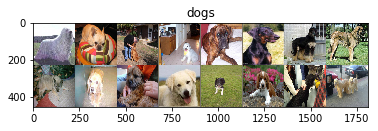

In [9]:
def show_images(inp, title=None, size=None):
    inp = inp.numpy().transpose((1, 2, 0))
    mean = np.array([0.485, 0.456, 0.406])
    std = np.array([0.229, 0.224, 0.225])
    inp = std * inp + mean
    inp = np.clip(inp, 0, 1)
    if size:
        plt.figure(figsize=size)
    plt.imshow(inp)
    if title is not None:
        plt.title(title)
    plt.pause(0.001)

inputs, classes = next(iter(dataloaders['train']))

# show images from single batch
out = torchvision.utils.make_grid(inputs)
show_images(out, title='dogs')

### Class distribution

We can see, that the class distribution of the dataset is reasonably good, though the larges class is nearly twice more common than the least common one. This means that the rarest classes like rottweiler and cockerspaniel are classified slightly more rarely than the others. 

This is however not the only problem in classification as several dog breeds appear similar. One example of this is the different labrador variants, their only real difference in appearance is their color.

Another example is Welsh springer spaniel and Brittany, which are mostly similar.

| Welsh springer spaniel | Brittany |
| --- | --- |
| 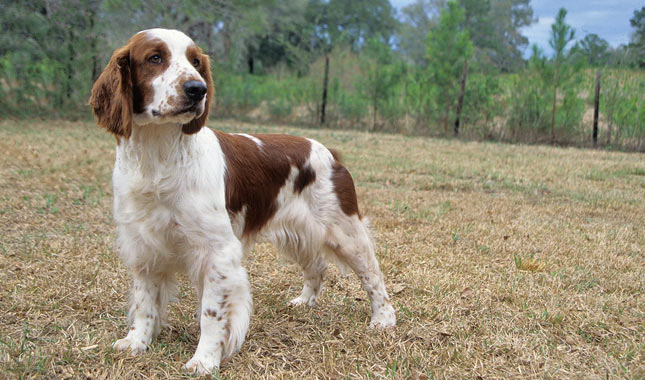  | 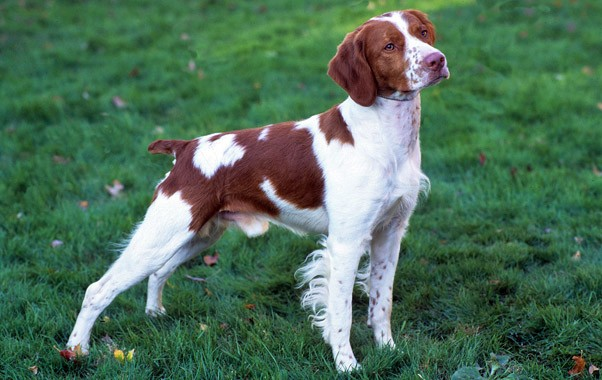 | 

Text(0.5, 1.0, 'Figure 1: Class distribution in the tranining set')

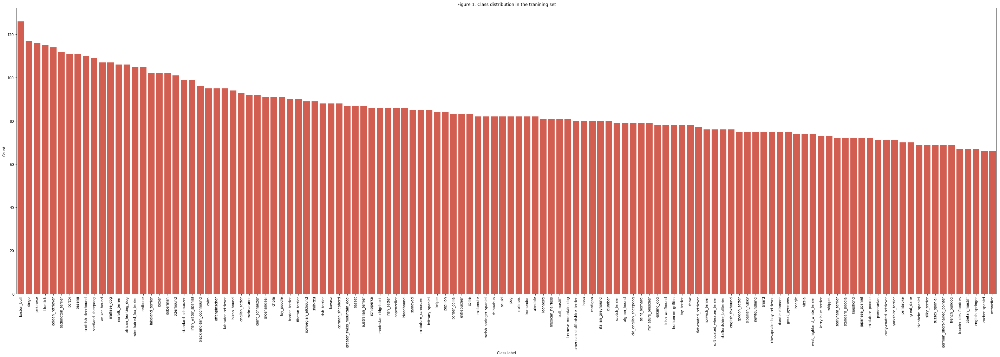

In [10]:
labels_data = pd.read_csv('data/labels.csv')
class_distribution = labels_data["breed"].value_counts()
fig = plt.figure(figsize=(50, 15))
fig.clf()
#ax = plt.subplot()
ax = sns.barplot(x=class_distribution.index,
                 y=class_distribution,
                 color='#e74c3c',
                 ax=plt.subplot())

ax.set_xticklabels(class_names, rotation='vertical', fontsize=10)
ax.set_xlabel('Class label')
ax.set_ylabel('Count')
ax.set_title('Figure 1: Class distribution in the tranining set')

## 3. Training

In this chapter I will be handling the creation and training of the models

### Training function

Here I define the training function which is used to train each model. The structure of training function is inspired by https://towardsdatascience.com/how-to-train-an-image-classifier-in-pytorch-and-use-it-to-perform-basic-inference-on-single-images-99465a1e9bf5.

The training function evaluates the accuracy of the model every 200 batches and prints the result. Finally the model is saved in a file.

The actual files are not on git, since they're too large for it. Compressed models are located in folder compressed_models. They are split to smaller files to avoid gits 100Mb file size limit.

In [21]:
def train_model(model, criterion, optimizer, name, num_epochs=25):
    start_time = datetime.datetime.now()
    steps = 0
    running_loss = 0.0
    print_every = 200
    n_test = len(dataloaders["test"])
    n_train = len(dataloaders["train"])
    train_losses, test_losses = [], []
    for epoch in range(num_epochs):
        for inputs, labels in dataloaders["train"]:
            inputs, labels = inputs.to(device), labels.to(device)
            steps += 1
            optimizer.zero_grad()
            logps = model.forward(inputs)
            loss = criterion(logps, labels)
            loss.backward()
            optimizer.step()
            running_loss += loss.item()
            if steps % print_every == 0:
                test_loss = 0
                model.eval()
                with torch.no_grad():
                    for inputs, labels in dataloaders["test"]:
                        inputs, labels = inputs.to(device), labels.to(device)
                        logps = model.forward(inputs)
                        batch_loss = criterion(logps, labels)
                        test_loss += batch_loss.item()

                        ps = torch.exp(logps)
                        top_p, top_class = ps.topk(1, dim=1)
                        equals = (top_class == labels.view(*top_class.shape))
                train_losses.append(running_loss/n_train)
                test_losses.append(test_loss/n_test)                    
                print(f"Epoch {epoch+1}/{num_epochs} ", end=' ')
                print(f"Train loss: {running_loss/print_every:.3f}", end=' ')
                print(f"Test loss: {test_loss/n_test:.3f}")
                running_loss = 0.0
                model.train()
    torch.save(model, name + '.pth')
    end_time = datetime.datetime.now()
    timedelta = end_time - start_time
    print(f"It took {timedelta} to train {name}")

### Create the models

In this project, I will be using Pytorches pretrained models. This will help in saving time to train the model.
https://pytorch.org/docs/master/torchvision/models.html

#### Resnet50 with Single trainable layer

The first model I will train is resnet50 (pretrained). After setting the pretrained model, the layers are "frozen", so the training does not affect them. Then the final layer is set as a single linear layer, which outputs in the 120 dog-classes. 
Then the optimizer is created with optim.SGD. Finally the model is set to cuda device to speed up training.

The model is similar as used in the course. This variant of resnet uses 50 layers as the name implies.

In [22]:
resnet_model = models.resnet50(pretrained=True)
for param in resnet_model.parameters():
    param.requires_grad = False

resnet_model.fc = nn.Linear(resnet_model.fc.in_features, len(class_names))

resnet_optimizer = optim.SGD(resnet_model.fc.parameters(), lr=0.001, momentum=0.9)
criterion = nn.CrossEntropyLoss().cuda()

resnet_model = resnet_model.cuda()

In [ ]:
print(cuda())

#### Training Resnet50

In [23]:
train_model(resnet_model, criterion, resnet_optimizer, "resnet50-2")

Epoch 1/25  Train loss: 4.284 Test loss: 3.544
Epoch 1/25  Train loss: 3.281 Test loss: 2.634
Epoch 2/25  Train loss: 2.510 Test loss: 1.961
Epoch 2/25  Train loss: 2.012 Test loss: 1.538
Epoch 2/25  Train loss: 1.683 Test loss: 1.303
Epoch 3/25  Train loss: 1.478 Test loss: 1.146
Epoch 3/25  Train loss: 1.315 Test loss: 1.046
Epoch 3/25  Train loss: 1.213 Test loss: 0.971
Epoch 4/25  Train loss: 1.114 Test loss: 0.899
Epoch 4/25  Train loss: 1.029 Test loss: 0.865
Epoch 5/25  Train loss: 0.985 Test loss: 0.822
Epoch 5/25  Train loss: 0.932 Test loss: 0.810
Epoch 5/25  Train loss: 0.918 Test loss: 0.741
Epoch 6/25  Train loss: 0.861 Test loss: 0.744
Epoch 6/25  Train loss: 0.844 Test loss: 0.719
Epoch 6/25  Train loss: 0.806 Test loss: 0.704
Epoch 7/25  Train loss: 0.783 Test loss: 0.688
Epoch 7/25  Train loss: 0.749 Test loss: 0.670
Epoch 7/25  Train loss: 0.764 Test loss: 0.677
Epoch 8/25  Train loss: 0.712 Test loss: 0.652
Epoch 8/25  Train loss: 0.720 Test loss: 0.650
Epoch 9/25  T

#### VGG16
from https://www.kaggle.com/carloalbertobarbano/vgg16-transfer-learning-pytorch

I simply take the pretrained vgg16 model, and replace its last layer with my own, like in the resnet50 above.

VGG was also used in the course material. This variant contains 16 layers, and the final layer is the one I will be changing

In [25]:
vgg_model = models.vgg16(pretrained=True)
for param in vgg_model.parameters():
    param.requires_grad = False

vgg_model.classifier[-1] = nn.Linear(vgg_model.classifier[-1].in_features, len(class_names))
vgg_optimizer = optim.SGD(vgg_model.classifier.parameters(), lr=0.001, momentum=0.9)
criterion = nn.CrossEntropyLoss().cuda()

vgg_model = vgg_model.cuda()

#### Training VGG16

In [26]:
train_model(vgg_model, criterion, vgg_optimizer, "vgg16-2")

Epoch 1/25  Train loss: 2.405 Test loss: 1.123
Epoch 1/25  Train loss: 1.124 Test loss: 0.844
Epoch 2/25  Train loss: 0.910 Test loss: 0.722
Epoch 2/25  Train loss: 0.742 Test loss: 0.697
Epoch 2/25  Train loss: 0.754 Test loss: 0.652
Epoch 3/25  Train loss: 0.688 Test loss: 0.652
Epoch 3/25  Train loss: 0.655 Test loss: 0.631
Epoch 3/25  Train loss: 0.639 Test loss: 0.606
Epoch 4/25  Train loss: 0.567 Test loss: 0.615
Epoch 4/25  Train loss: 0.550 Test loss: 0.620
Epoch 5/25  Train loss: 0.574 Test loss: 0.592
Epoch 5/25  Train loss: 0.504 Test loss: 0.601
Epoch 5/25  Train loss: 0.546 Test loss: 0.612
Epoch 6/25  Train loss: 0.500 Test loss: 0.610
Epoch 6/25  Train loss: 0.492 Test loss: 0.586
Epoch 6/25  Train loss: 0.483 Test loss: 0.577
Epoch 7/25  Train loss: 0.471 Test loss: 0.575
Epoch 7/25  Train loss: 0.438 Test loss: 0.578
Epoch 7/25  Train loss: 0.474 Test loss: 0.590
Epoch 8/25  Train loss: 0.399 Test loss: 0.580
Epoch 8/25  Train loss: 0.450 Test loss: 0.587
Epoch 9/25  T

#### Resnet152 with multiple trainable layers

This time I will be using resnet152 with more complex trainable layers. I expect that it's accuracy would be at least the same as in the resnet50 previously.

Another resnet with 152 layers.

In [27]:
resnet152_model = models.resnet152(pretrained=True)
for param in resnet152_model.parameters():
    param.requires_grad = False

resnet152_model.fc = nn.Sequential(
                nn.Linear(resnet152_model.fc.in_features, 4096),
                nn.ReLU(inplace=True),
                nn.Dropout(p=0.1),
                nn.Linear(4096, len(class_names)),
                nn.ReLU(inplace=True),
                nn.Dropout(p=0.1),
            )

resnet152_optimizer = optim.SGD(resnet152_model.fc.parameters(), lr=0.001, momentum=0.9)
criterion = nn.CrossEntropyLoss().cuda()

resnet152_model = resnet152_model.cuda()

Downloading: "https://download.pytorch.org/models/resnet152-b121ed2d.pth" to C:\Users\Kekkonen/.torch\models\resnet152-b121ed2d.pth
241530880it [00:05, 41012111.09it/s]


#### Training Resnet152

In [28]:
train_model(resnet152_model, criterion, resnet152_optimizer, "resnet152")

Epoch 1/25  Train loss: 4.650 Test loss: 4.449
Epoch 1/25  Train loss: 4.259 Test loss: 3.936
Epoch 2/25  Train loss: 3.819 Test loss: 3.423
Epoch 2/25  Train loss: 3.441 Test loss: 3.089
Epoch 2/25  Train loss: 3.102 Test loss: 2.774
Epoch 3/25  Train loss: 2.937 Test loss: 2.654
Epoch 3/25  Train loss: 2.826 Test loss: 2.537
Epoch 3/25  Train loss: 2.789 Test loss: 2.451
Epoch 4/25  Train loss: 2.673 Test loss: 2.360
Epoch 4/25  Train loss: 2.624 Test loss: 2.299
Epoch 5/25  Train loss: 2.541 Test loss: 2.248
Epoch 5/25  Train loss: 2.520 Test loss: 2.229
Epoch 5/25  Train loss: 2.430 Test loss: 2.161
Epoch 6/25  Train loss: 2.454 Test loss: 2.148
Epoch 6/25  Train loss: 2.408 Test loss: 2.110
Epoch 6/25  Train loss: 2.390 Test loss: 2.090
Epoch 7/25  Train loss: 2.318 Test loss: 2.098
Epoch 7/25  Train loss: 2.314 Test loss: 2.067
Epoch 7/25  Train loss: 2.345 Test loss: 2.058
Epoch 8/25  Train loss: 2.277 Test loss: 2.052
Epoch 8/25  Train loss: 2.287 Test loss: 2.042
Epoch 9/25  T

#### Densenet

Trying densenet with the same setup from other networks, this time using densenet.

Densenet is a type of CNN in layers are attached to each other. This aims to increase accuracy, efficiency and depth of the network. As seen in the image below, each layer in a Densenet block receives feature maps of previous layers.

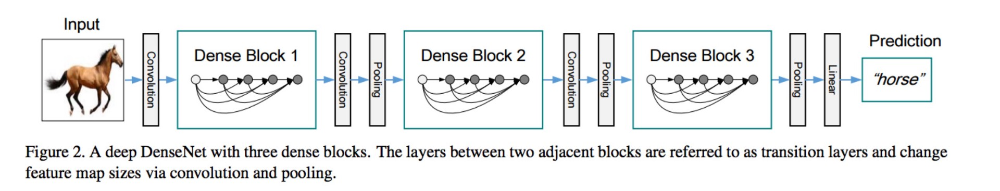

The densenet is formed with Denseblocks, which contain denselayers, which contain more traditional components. Each denseblock connects to another block via Transition. In total, there are 160 layers + classifier in the network

<b>Denselayer</b>:<br>
    BatchNorm2d<br>
    ReLu<br>
    Conv2d<br>
    BatchNorm2d<br>
    Relu<br>
    Conv2d<br>
    
<b>Transition</b>:<br>
    BatchNorm2d<br>
    ReLu<br>
    Conv2d<br>
    AvgPool2d<br>
    Conv2d<br>

https://pytorch.org/docs/stable/_modules/torchvision/models/densenet.html<br>
https://arxiv.org/pdf/1608.06993.pdf

In [29]:
densenet_model = models.densenet161(pretrained=True)
for param in densenet_model.parameters():
    param.requires_grad = False

densenet_model.classifier = nn.Linear(densenet_model.classifier.in_features, len(class_names))
densenet_optimizer = torch.optim.Adam(densenet_model.parameters())
criterion = nn.CrossEntropyLoss().cuda()

densenet_model = densenet_model.cuda()

Downloading: "https://download.pytorch.org/models/densenet161-8d451a50.pth" to C:\Users\Kekkonen/.torch\models\densenet161-8d451a50.pth
115730790it [00:05, 21129044.69it/s]


In [30]:
train_model(densenet_model, criterion, densenet_optimizer, "densenet")

Epoch 1/25  Train loss: 2.863 Test loss: 1.255
Epoch 1/25  Train loss: 1.216 Test loss: 0.783
Epoch 2/25  Train loss: 0.853 Test loss: 0.627
Epoch 2/25  Train loss: 0.617 Test loss: 0.666
Epoch 2/25  Train loss: 0.591 Test loss: 0.567
Epoch 3/25  Train loss: 0.521 Test loss: 0.557
Epoch 3/25  Train loss: 0.437 Test loss: 0.558
Epoch 3/25  Train loss: 0.470 Test loss: 0.515
Epoch 4/25  Train loss: 0.362 Test loss: 0.522
Epoch 4/25  Train loss: 0.351 Test loss: 0.524
Epoch 5/25  Train loss: 0.343 Test loss: 0.511
Epoch 5/25  Train loss: 0.281 Test loss: 0.517
Epoch 5/25  Train loss: 0.308 Test loss: 0.548
Epoch 6/25  Train loss: 0.270 Test loss: 0.510
Epoch 6/25  Train loss: 0.220 Test loss: 0.518
Epoch 6/25  Train loss: 0.249 Test loss: 0.572
Epoch 7/25  Train loss: 0.222 Test loss: 0.581
Epoch 7/25  Train loss: 0.197 Test loss: 0.582
Epoch 7/25  Train loss: 0.240 Test loss: 0.574
Epoch 8/25  Train loss: 0.166 Test loss: 0.554
Epoch 8/25  Train loss: 0.181 Test loss: 0.528
Epoch 9/25  T

### Alexnet

Here I use the classic alexnet, just as the other networks. The simple model only contains 8 layers. Very economical

In [23]:
print(alexnet_model)

AlexNet(
  (features): Sequential(
    (0): Conv2d(3, 64, kernel_size=(11, 11), stride=(4, 4), padding=(2, 2))
    (1): ReLU(inplace)
    (2): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (3): Conv2d(64, 192, kernel_size=(5, 5), stride=(1, 1), padding=(2, 2))
    (4): ReLU(inplace)
    (5): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
    (6): Conv2d(192, 384, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): ReLU(inplace)
    (8): Conv2d(384, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (9): ReLU(inplace)
    (10): Conv2d(256, 256, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (11): ReLU(inplace)
    (12): MaxPool2d(kernel_size=3, stride=2, padding=0, dilation=1, ceil_mode=False)
  )
  (avgpool): AdaptiveAvgPool2d(output_size=(6, 6))
  (classifier): Sequential(
    (0): Dropout(p=0.5)
    (1): Linear(in_features=9216, out_features=4096, bias=True)
    (2): ReLU(inplace)
    (3): Dropout(p

In [31]:
alexnet_model = models.alexnet(pretrained=True)
for param in alexnet_model.parameters():
    param.requires_grad = False
alexnet_model.classifier[-1] = nn.Linear(in_features=alexnet_model.classifier[-1].in_features,
                                         out_features=len(class_names))

alexnet_optimizer = optim.SGD(alexnet_model.parameters(), lr=0.001, momentum=0.9)
criterion = nn.CrossEntropyLoss().cuda()

alexnet_model = alexnet_model.cuda()

Downloading: "https://download.pytorch.org/models/alexnet-owt-4df8aa71.pth" to C:\Users\Kekkonen/.torch\models\alexnet-owt-4df8aa71.pth
244418560it [00:05, 42203363.52it/s]


In [32]:
train_model(alexnet_model, criterion, alexnet_optimizer, "alexnet-2")

Epoch 1/25  Train loss: 3.101 Test loss: 2.192
Epoch 1/25  Train loss: 2.258 Test loss: 1.934
Epoch 2/25  Train loss: 1.923 Test loss: 1.844
Epoch 2/25  Train loss: 1.367 Test loss: 1.816
Epoch 2/25  Train loss: 1.470 Test loss: 1.792
Epoch 3/25  Train loss: 1.168 Test loss: 1.765
Epoch 3/25  Train loss: 1.036 Test loss: 1.809
Epoch 3/25  Train loss: 1.137 Test loss: 1.753
Epoch 4/25  Train loss: 0.844 Test loss: 1.748
Epoch 4/25  Train loss: 0.841 Test loss: 1.700
Epoch 5/25  Train loss: 0.853 Test loss: 1.723
Epoch 5/25  Train loss: 0.597 Test loss: 1.727
Epoch 5/25  Train loss: 0.691 Test loss: 1.731
Epoch 6/25  Train loss: 0.627 Test loss: 1.795
Epoch 6/25  Train loss: 0.532 Test loss: 1.747
Epoch 6/25  Train loss: 0.622 Test loss: 1.732
Epoch 7/25  Train loss: 0.516 Test loss: 1.794
Epoch 7/25  Train loss: 0.486 Test loss: 1.781
Epoch 7/25  Train loss: 0.540 Test loss: 1.786
Epoch 8/25  Train loss: 0.392 Test loss: 1.761
Epoch 8/25  Train loss: 0.411 Test loss: 1.773
Epoch 9/25  T

## Evaluation

In this chapter, I evaluate the results gained from the training the networks.

#### Load models from disk

In [7]:
resnet_model = torch.load('resnet50-2.pth')
resnet152_model = torch.load('resnet152.pth')
vgg_model = torch.load('vgg16-2.pth')
densenet_model = torch.load('densenet.pth')
alexnet_model = torch.load('alexnet-2.pth')

### Accuracy

Here I check the test accuracy of all the models.

In [33]:
def compute_accuracy(model, testloader):
    model.eval()
    correct = 0
    total = 0
    with torch.no_grad():
        for images, labels in testloader:
            images, labels = images.to(device), labels.to(device)
            outputs = model(images)
            _, predicted = torch.max(outputs.data, 1)
            total += labels.size(0)
            correct += (predicted == labels).sum().item()
    return correct / total


In [34]:
def compute_log_loss(model, testloader):
    model.eval()
    test_loss = 0
    criterion = nn.CrossEntropyLoss().cuda()
    for inputs, labels in testloader:
        inputs, labels = inputs.to(device), labels.to(device)
        logps = model.forward(inputs)
        batch_loss = criterion(logps, labels)
        test_loss += batch_loss.item()
    return test_loss/len(testloader)

In [35]:
# Computing the accuracy of each model
acc_alexnet = compute_accuracy(alexnet_model, dataloaders['test'])
acc_resnet152 = compute_accuracy(resnet152_model, dataloaders['test'])
acc_resnet50 = compute_accuracy(resnet_model, dataloaders['test'])
acc_densenet = compute_accuracy(densenet_model, dataloaders['test'])
acc_vgg = compute_accuracy(vgg_model, dataloaders['test'])

In [36]:
# Compute logloss
log_loss_alexnet = compute_log_loss(alexnet_model, dataloaders['test'])
log_loss_resnet152 = compute_log_loss(resnet152_model, dataloaders['test'])
log_loss_resnet50 = compute_log_loss(resnet_model, dataloaders['test'])
log_loss_densenet = compute_log_loss(densenet_model, dataloaders['test'])
log_loss_vgg = compute_log_loss(vgg_model, dataloaders['test'])

In [37]:
# Printing results
print("accuracy of alexnet was {}, logloss was {}".format(acc_alexnet, log_loss_alexnet))
print("accuracy of resnet152 was {}, logloss was {}".format(acc_resnet152, log_loss_resnet152))
print("accuracy of resnet50 was {}, logloss was {}".format(acc_resnet50, log_loss_resnet50))
print("accuracy of densenet was {}, logloss was {}".format(acc_densenet, log_loss_densenet))
print("accuracy of vgg was {}, logloss was {}".format(acc_vgg, log_loss_vgg))

accuracy of alexnet was 0.5649054142204827, logloss was 1.8999935146421194
accuracy of resnet152 was 0.6262230919765166, logloss was 1.8779450279350083
accuracy of resnet50 was 0.8297455968688845, logloss was 0.5558619853109121
accuracy of densenet was 0.8369210697977821, logloss was 0.7097640020462374
accuracy of vgg was 0.8153946510110893, logloss was 0.5984468072031935


Most of the models reach accuracy of more than 80%, with the exception of resnet152 and Alexnet. Resnet152 is the only model with multiple trainable layers and therefore it could help to give it more epochs. Still, the rest of the models are very accurate. Alexnet on the other hand has very few layers.

It appears the simple alexnet was able to reach accuracy above the resnet/vggs, despite its simplicity. It seems the more advanced models were unneccesarily complex, and resnet152s performance is reflected in this. Resnet152s bad performance cannot be entirely from amount of layers & complexity though, since densenet161 was the most accurate. It is more reasonable to blame the bad performance on the self-trained part. The logloss follows the same pattern, with resnet152 firmly as the worst model.

If the results would realisticly represent the same performance on the actual testing data, I would almost be in top 150 with my result on densenet. 

Below are the results ordered in a table.

| Model |Accuracy | Log loss |
| --- | --- | --- |
| 'Densenet' | 83.69% | 0.70976 |
| 'vgg' | 81.54% | 0.59845 |
| 'alexnet' | 56.49% | 1.89999 |
| 'resnet50' | 82.97% | 0.55586 |
| 'Resnet152' | 62.62% | 1.87795 |

### Confusion matrix

Confusion matrix is a table which can be used to describe the performance of classification models. It is a matrix with slots for predicted classes, and actual classes. From the matrix it is possible to see, if the classifier made mistakes. More specifically it shows what class was predicted, and what class was the correct solution. A perfect confusion matrix is a identity matrix, with all values in the main diagonal, and zeros everywhere else. The more values outside main diagonal, the more inaccurate the model is.

We create confusion matrices for each of our models. The same function is used to normal confusion matrices and normalized confusion matrices.

The images are high resolution, and it can be difficult to see the labels without zooming close. Also the grid is very large, but it can be seen that the models are rather accurate. The most inaccurate appears to be resnet152, which is rather sad since it is the most complicated of the bunch.

In [38]:
def plot_confusion_matrix(model, testloader, classes,
                          normalize=False,
                          title='(Humongous) Confusion matrix',
                          cmap=plt.cm.Blues):
    model.eval()
    cm = torch.zeros(len(classes), len(classes))
    with torch.no_grad():
        for i, (inputs, classes_t) in enumerate(testloader):
            inputs = inputs.to(device)
            classes_t = classes_t.to(device)
            outputs = model(inputs)
            _, preds = torch.max(outputs, 1)
            for t, p in zip(classes_t.view(-1), preds.view(-1)):
                    cm[t.long(), p.long()] += 1

    cm = np.array(cm)   
    
    if normalize:
        cm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]
    plt.figure(figsize=(50,50))
    plt.imshow(cm, interpolation='nearest', cmap=cmap)
    plt.title(title, fontsize=50)
    plt.colorbar()
    tick_marks = np.arange(len(classes))
    plt.xticks(tick_marks, classes)
    plt.yticks(tick_marks, classes)

    thresh = cm.max() / 2.
    for i, j in itertools.product(range(cm.shape[0]), range(cm.shape[1])):
        if (cm[i, j] != 0):
            if normalize:
                text = "{0:.2f}".format(cm[i, j])
            else:
                text = "{0:.0f}".format(cm[i, j])
        else:
            text = "0"
        plt.text(j, i, text,
                 horizontalalignment="center",
                 color="white" if cm[i, j] > thresh else "black")

    plt.ylabel('True label', fontsize=40)
    plt.xlabel('Predicted label', fontsize=40)
    plt.tight_layout()

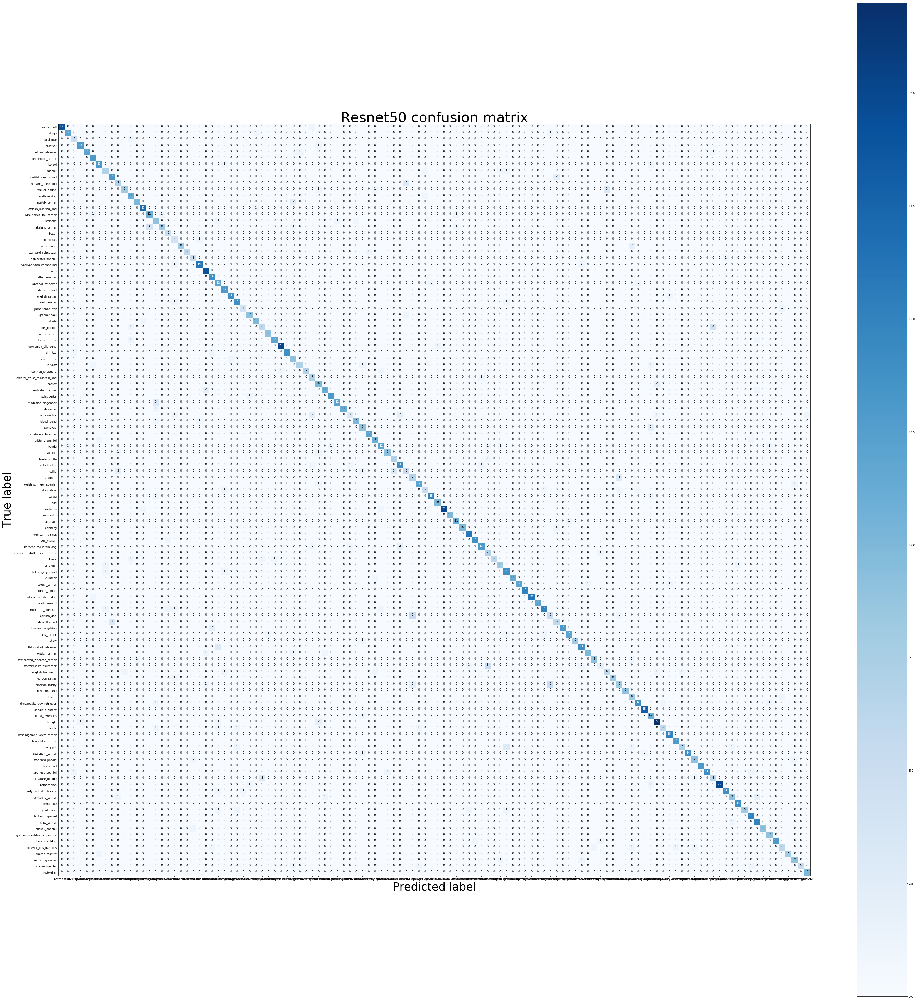

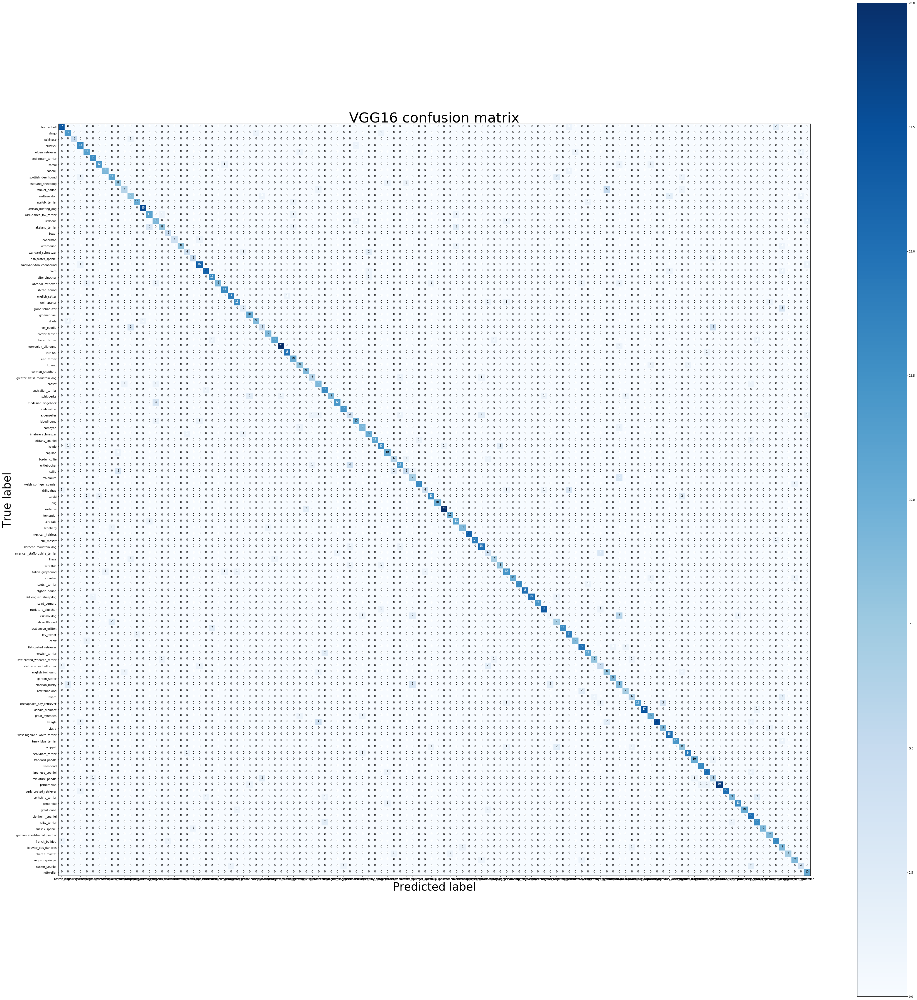

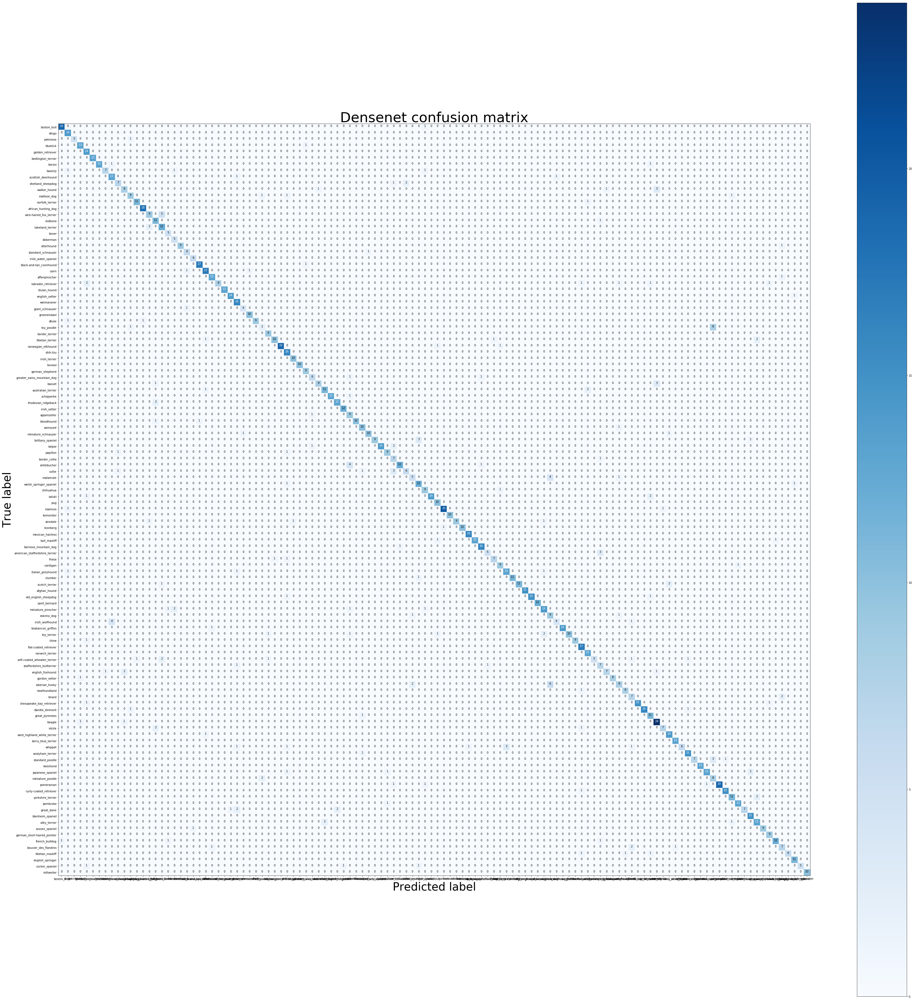

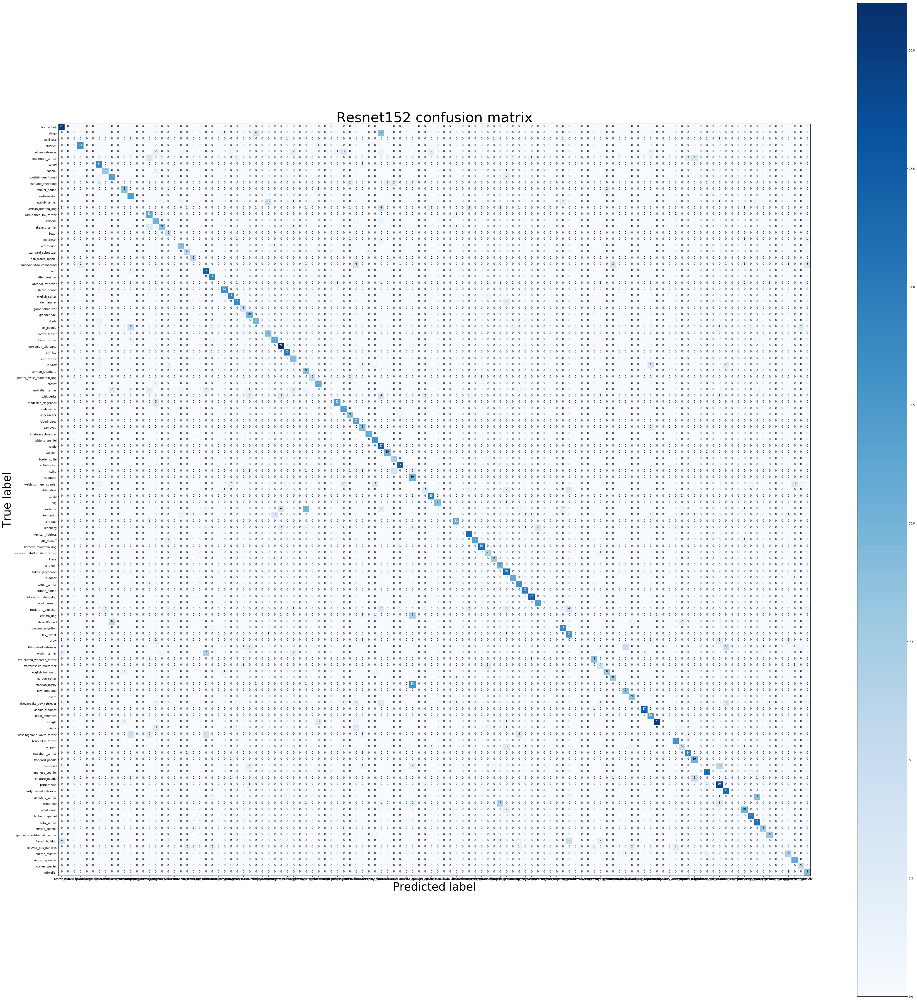

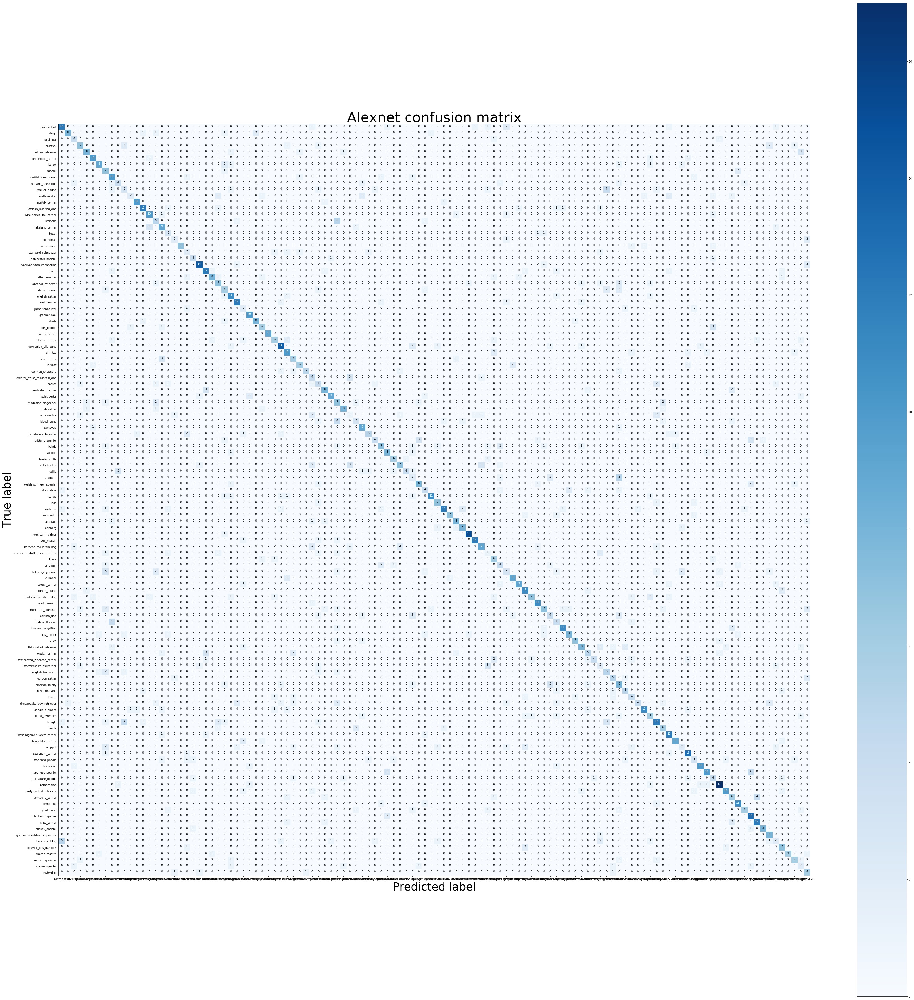

In [39]:
# calculate and plot confusion matrices
plot_confusion_matrix(resnet_model, dataloaders["test"], class_names, title="Resnet50 confusion matrix")
plot_confusion_matrix(vgg_model, dataloaders["test"], class_names, title="VGG16 confusion matrix")
plot_confusion_matrix(densenet_model, dataloaders["test"], class_names, title="Densenet confusion matrix")
plot_confusion_matrix(resnet152_model, dataloaders["test"], class_names, title="Resnet152 confusion matrix")
plot_confusion_matrix(alexnet_model, dataloaders["test"], class_names, title="Alexnet confusion matrix")

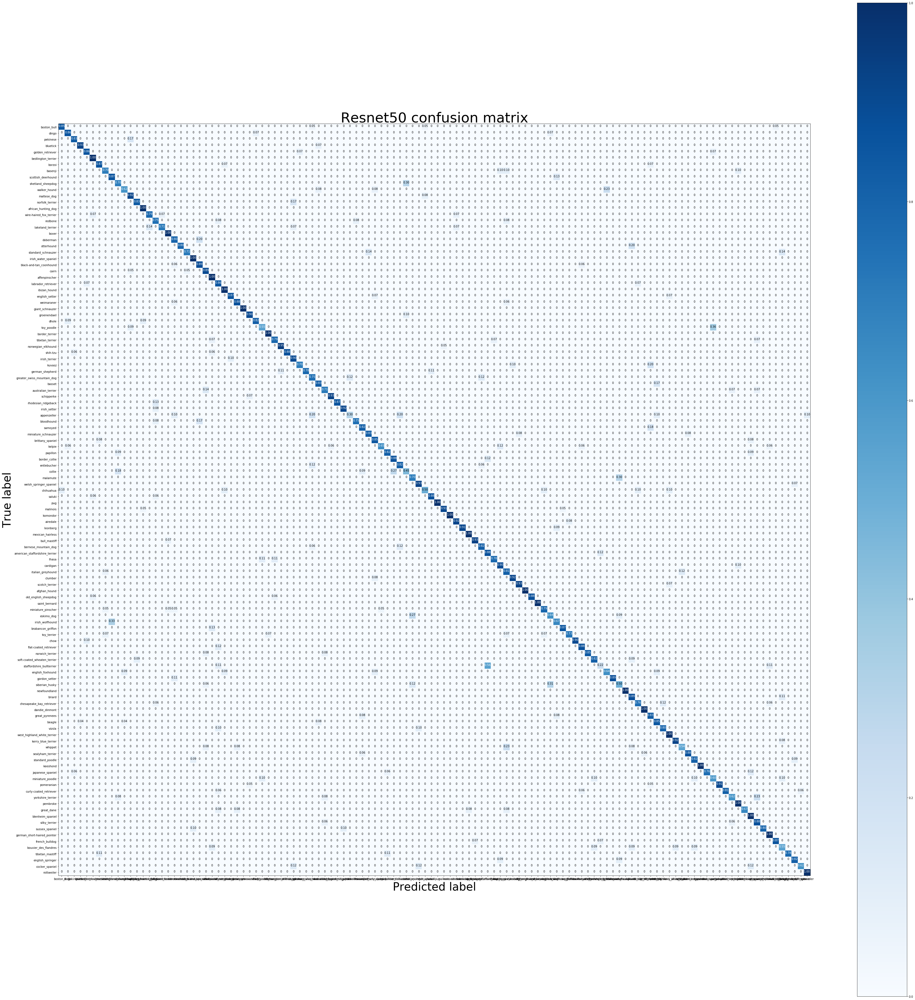

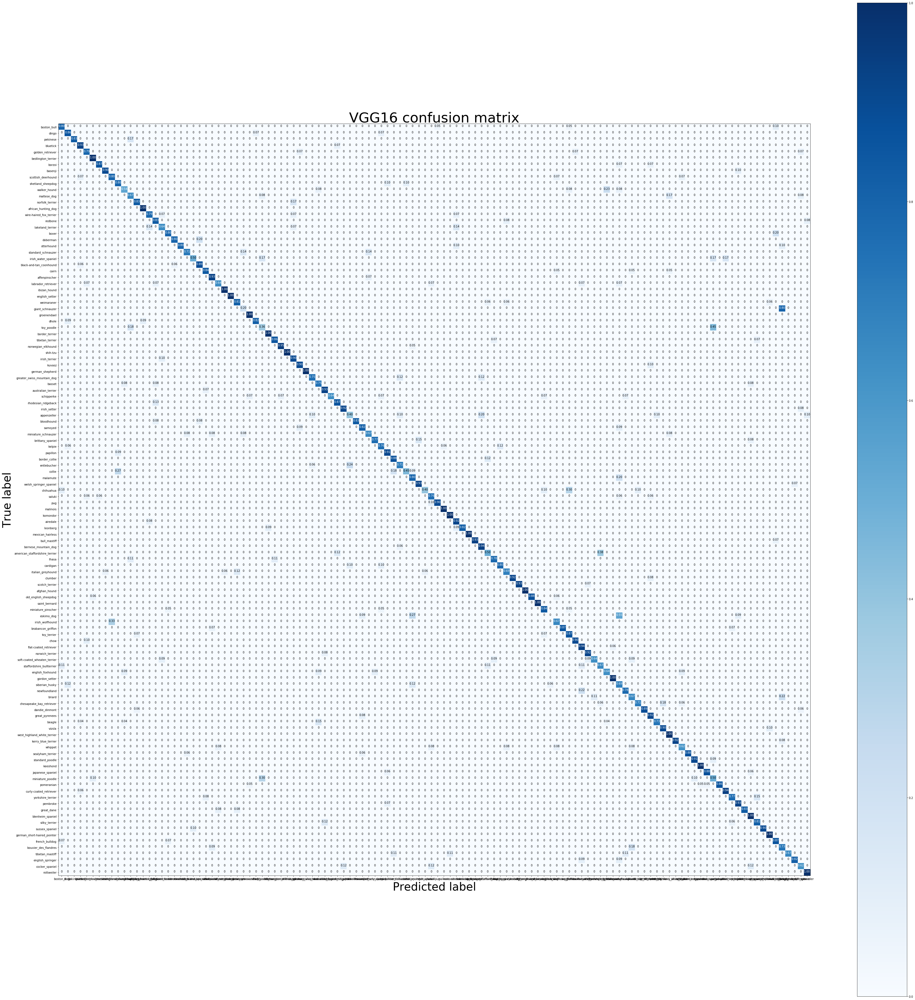

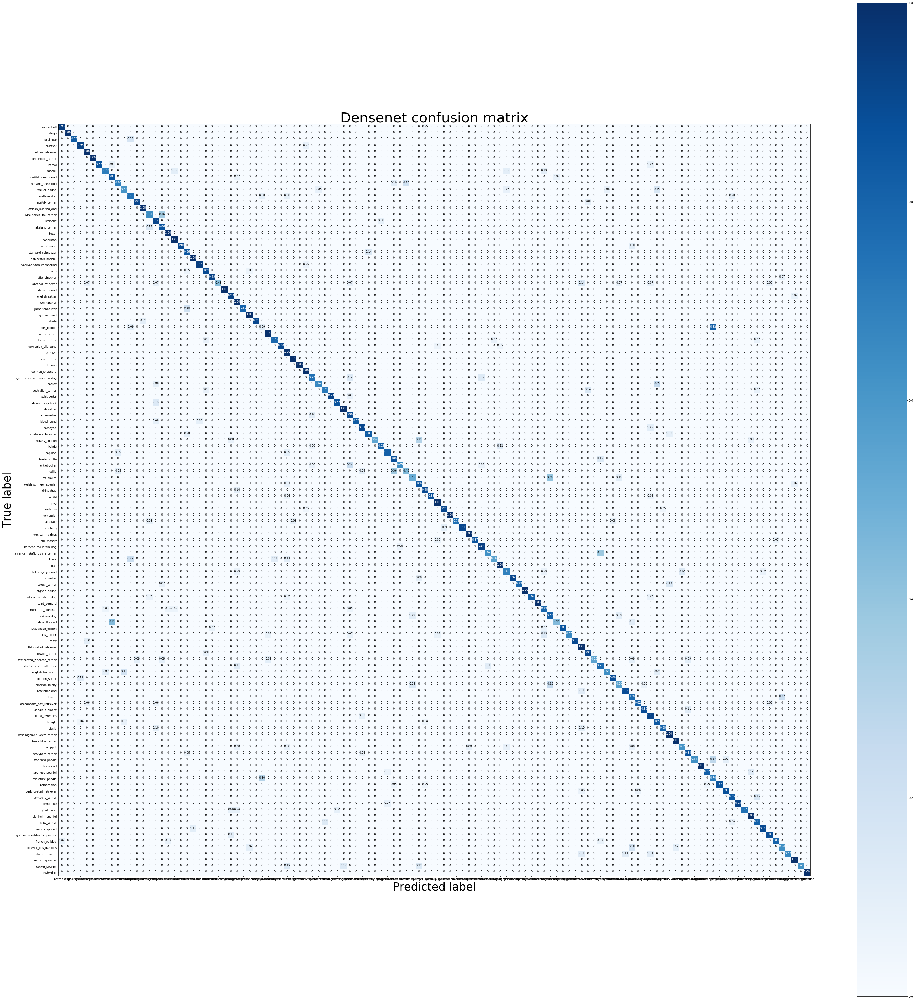

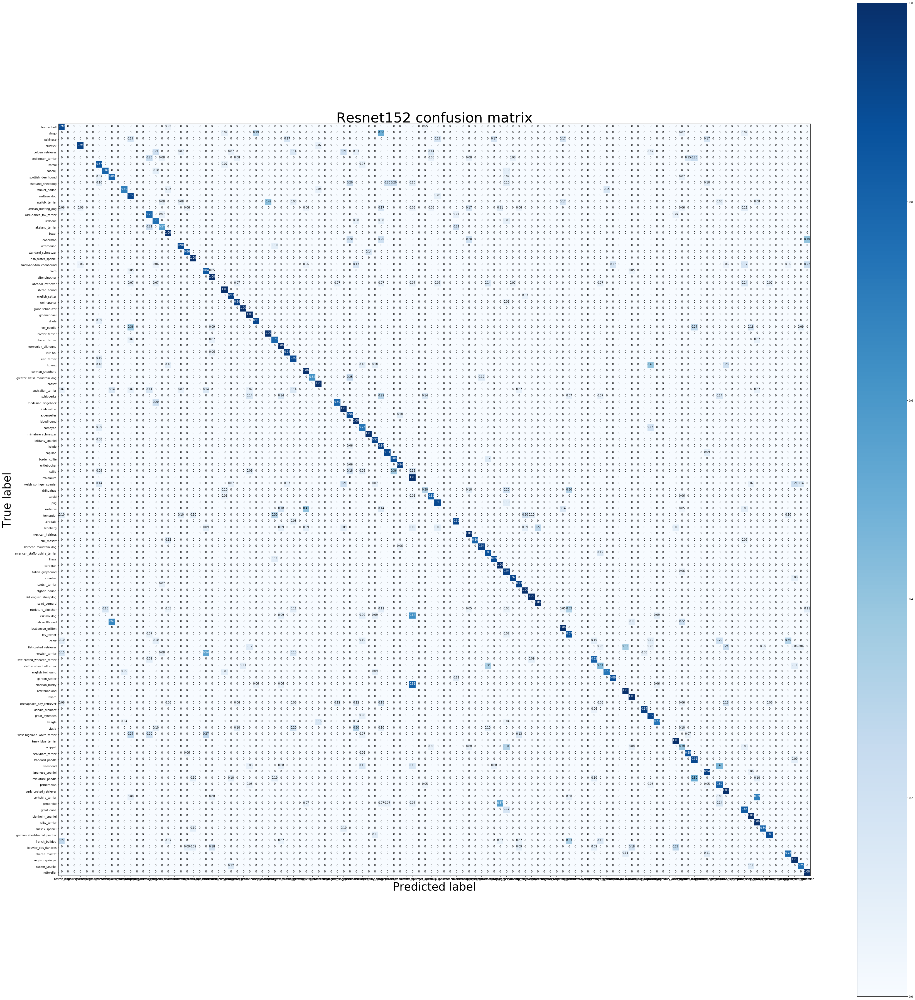

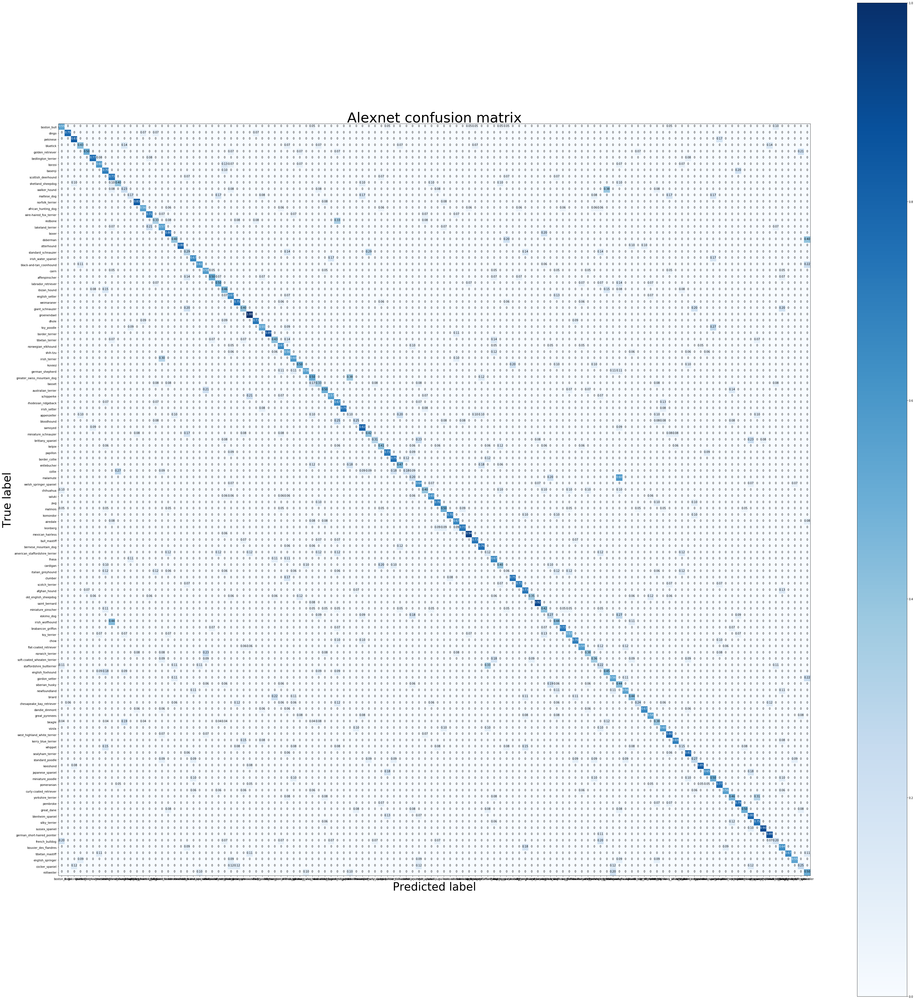

In [40]:
# create normalized confusion matrices
plot_confusion_matrix(resnet_model, dataloaders["test"], class_names, normalize=True, title="Resnet50 confusion matrix")
plot_confusion_matrix(vgg_model, dataloaders["test"], class_names, normalize=True, title="VGG16 confusion matrix")
plot_confusion_matrix(densenet_model, dataloaders["test"], class_names, normalize=True, title="Densenet confusion matrix")
plot_confusion_matrix(resnet152_model, dataloaders["test"], class_names, normalize=True, title="Resnet152 confusion matrix")
plot_confusion_matrix(alexnet_model, dataloaders["test"], class_names, normalize=True, title="Alexnet confusion matrix")

### Confusion matrix results

From the matrices it seems most models struggled to classify breeds such as Lhasa, different terriers, eskimo_dog etc. In the case of resnet152, some entire breeds have been misclassified. On other models, most of the dogs seem to be correctly classified.

### classification visual representation

Here I evaluate the results. Visualize_classifications function will visualize models classifications both correct and incorrect. In short, the function goes through the testloader and lists the first 6 images of either correct or incorrect nature. If in incorrect mode, a image of classified breed is also shown to display better the accuracy of the model.

In [41]:
def get_real_breed(breed):
    found = False
    for _ in range(len(dataloaders["train"])):
        images, labels = iter(dataloaders["train"]).next()
        for j in range(images.size()[0]):
            if class_names[labels.data[j]] == breed:
                return images.cpu().data[j]

In [42]:
rcParams['figure.figsize'] = 20, 20
def visualize_classifications(model, correct=True):
    count = 6
    model.eval()
    classification = 0
    fig = plt.figure()

    for _, data in enumerate(dataloaders['test']):
        inputs, labels = data
        inputs, labels = Variable(inputs.cuda()), Variable(labels.cuda())
        outputs = model(inputs)
        _, preds = torch.max(outputs.data, 1)
        
        for j in range(inputs.size()[0]):
            if correct:
                check = (class_names[preds[j]] == class_names[labels.data[j]])
            else:
                check = (class_names[preds[j]] != class_names[labels.data[j]])
            if check:
                classification += 1
                ax = plt.subplot(count//2, 2, classification)
                ax.axis('off')
                ax.set_title('predicted: {}, actual: {}'.format(class_names[preds[j]], class_names[labels.data[j]]))
                show_images(inputs.cpu().data[j])
                if not correct:
                    ax2 = plt.subplot(count//2, 2, classification)
                    ax2.axis('off')
                    ax2.set_title('actual {}'.format(class_names[labels.data[j]]))
                    show_images(get_real_breed(class_names[labels.data[j]]))
                    ax3 = plt.subplot(count//2, 2, classification)
                    ax3.axis('off')
                    ax3.set_title('actual {}'.format(class_names[preds[j]]))
                    show_images(get_real_breed(class_names[preds[j]]))
                if classification != count:
                    print(' --------------------')
                    print('|       NEXT         |')
                    print(' --------------------')

            if classification == count:
                return

### Visualizing models
When visualizing models, it can be seen that most of the errors are from very similar breeds. It is also apparent that some images are not very good - they contain multiple dogs or other entities, or the dog is badly visible or a puppy. Still, most of the faults are from clearly similar dogs.

I did not keep the correct visualization - parts since they did not bring anything fascinating to the mix. They can be easily brought back by uncommenting them.

#### Alexnet mistakes

Alexnet's mistakes appear to be mostly from breeds similar to each other. For example appenzeller and entlebucher.

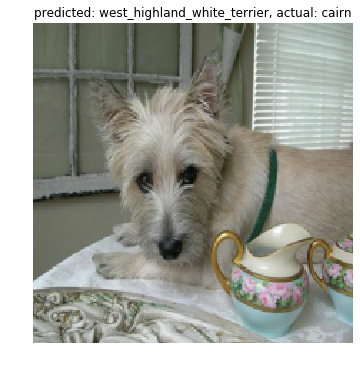

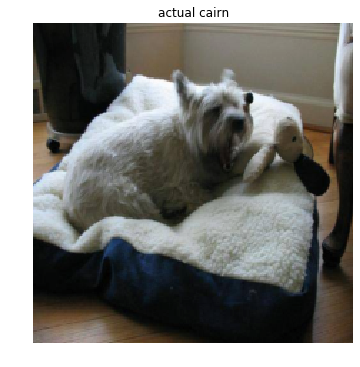

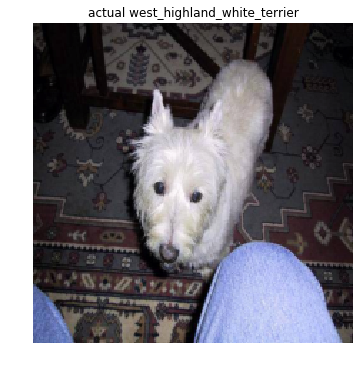

 --------------------
|       NEXT         |
 --------------------


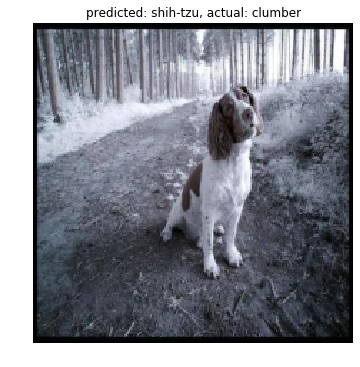

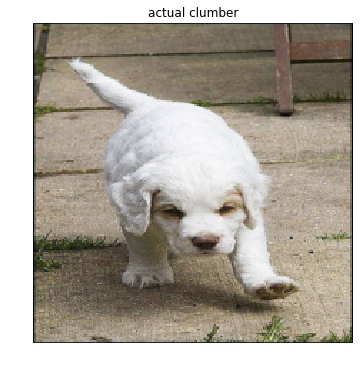

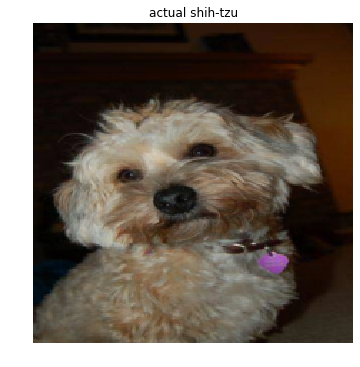

 --------------------
|       NEXT         |
 --------------------


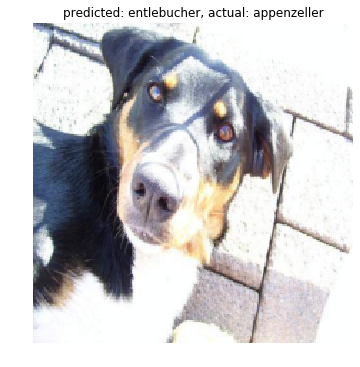

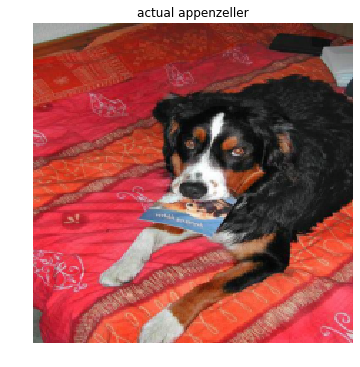

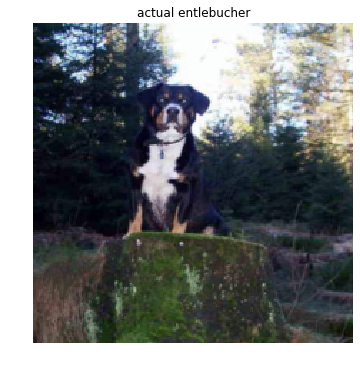

 --------------------
|       NEXT         |
 --------------------


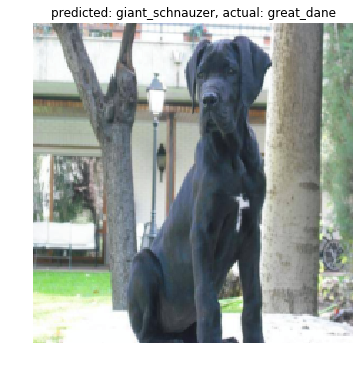

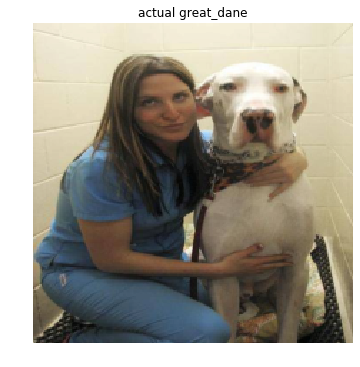

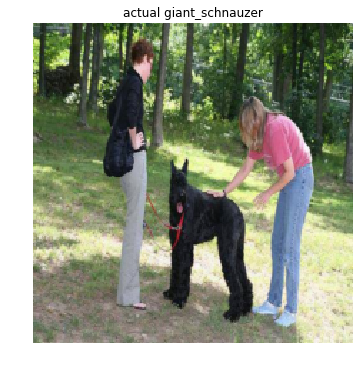

 --------------------
|       NEXT         |
 --------------------


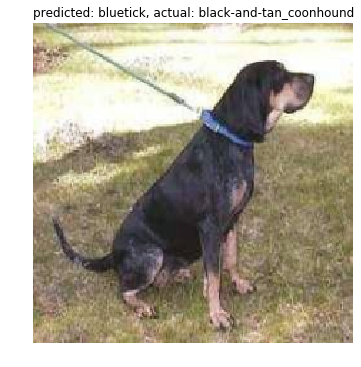

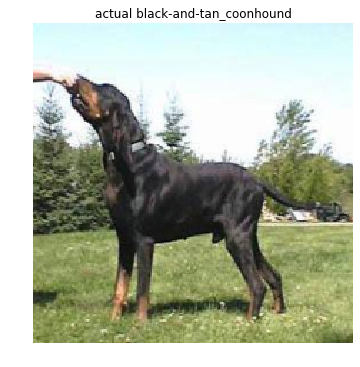

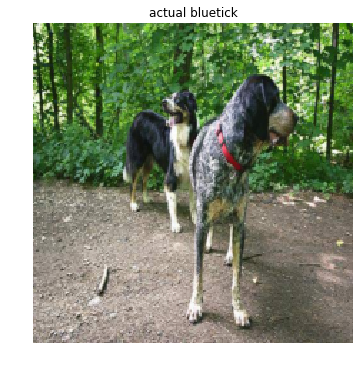

 --------------------
|       NEXT         |
 --------------------


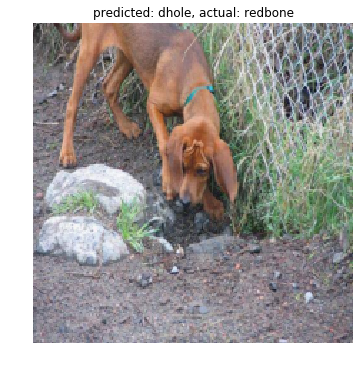

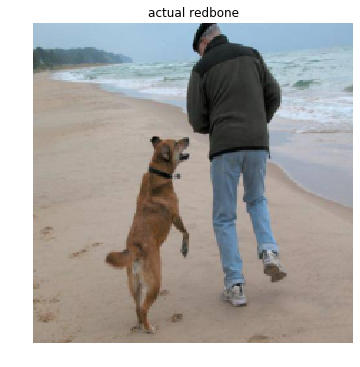

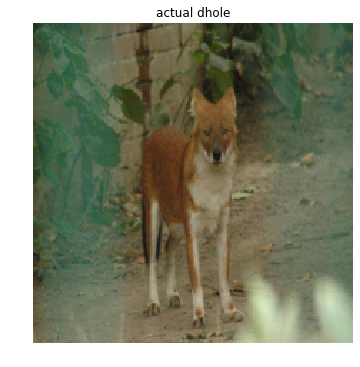

In [43]:
# Alexnet mistakes
visualize_classifications(alexnet_model, correct=False)
# visualize_classifications(densenet_model, correct=True)

#### densenet mistakes

Densenet's mistakes are all very small, in this set mostly spaniels and terriers. One issue here is that some puppies appear more like other breeds as their own.

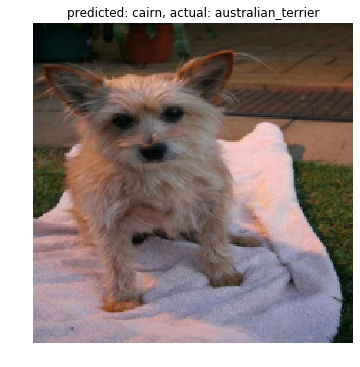

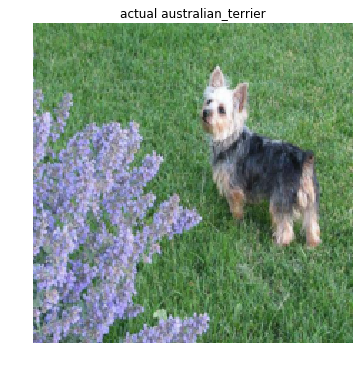

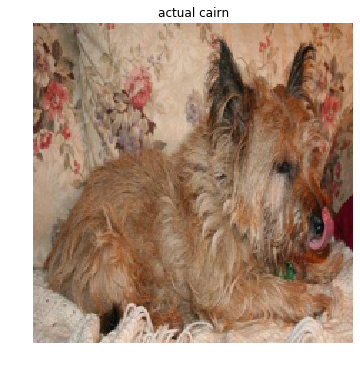

 --------------------
|       NEXT         |
 --------------------


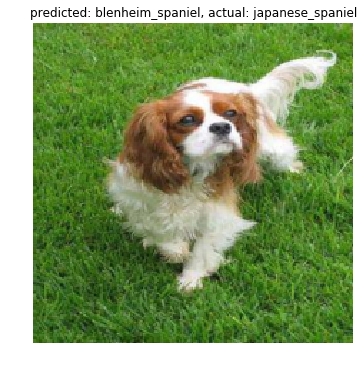

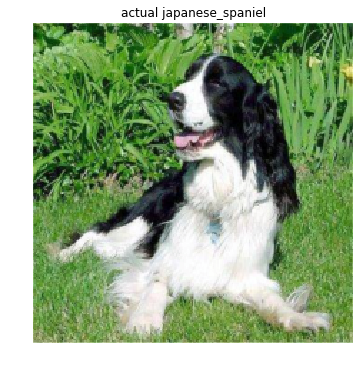

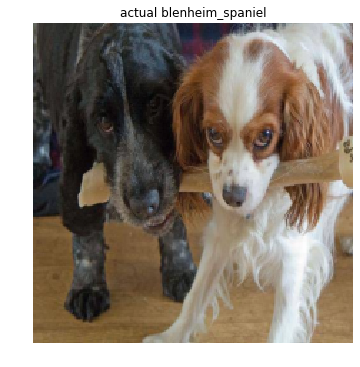

 --------------------
|       NEXT         |
 --------------------


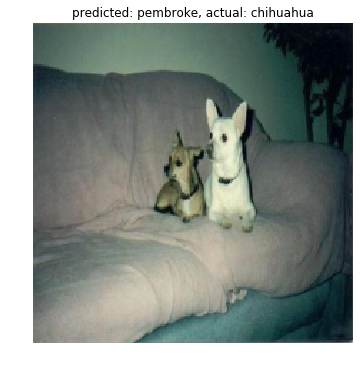

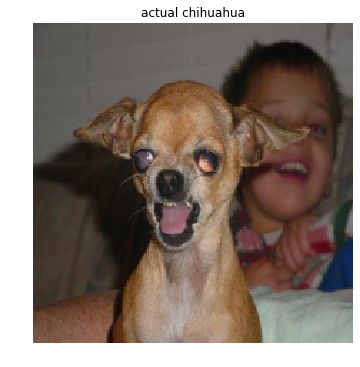

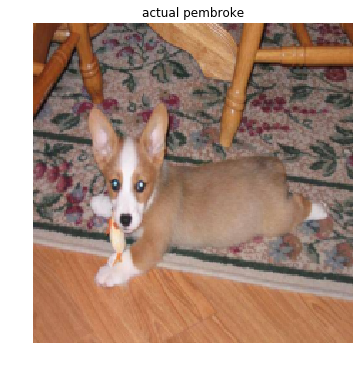

 --------------------
|       NEXT         |
 --------------------


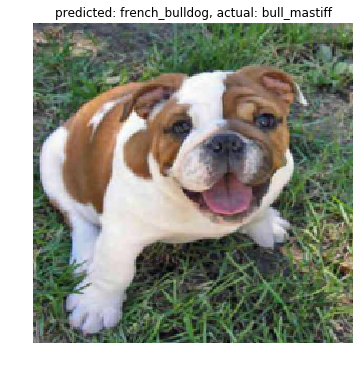

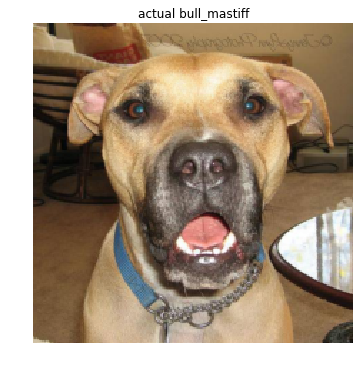

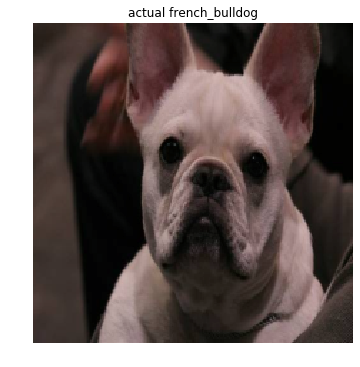

 --------------------
|       NEXT         |
 --------------------


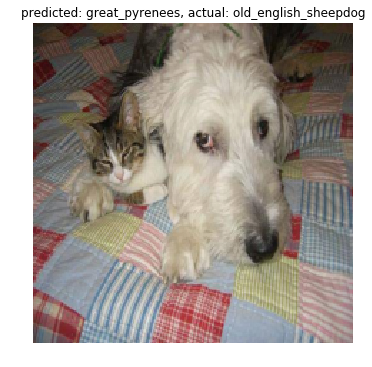

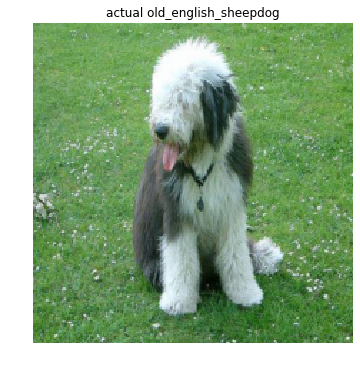

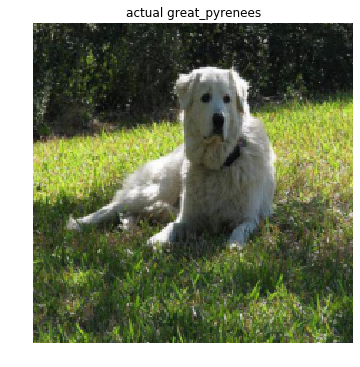

 --------------------
|       NEXT         |
 --------------------


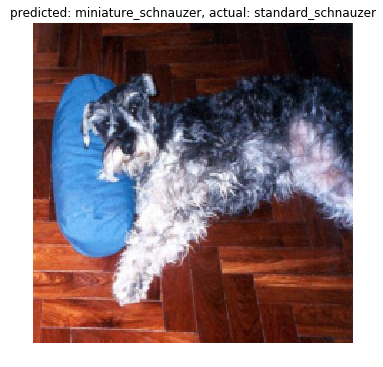

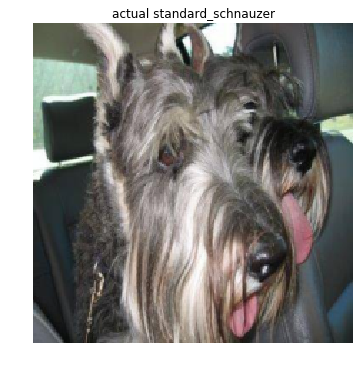

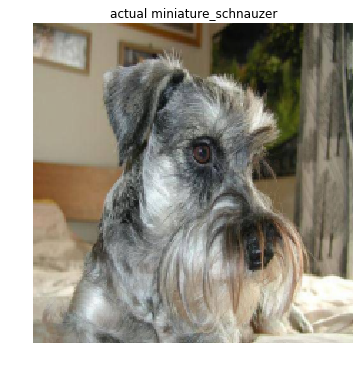

In [44]:
visualize_classifications(densenet_model, correct=False)
# visualize_classifications(densenet_model, correct=True)

#### resnet50 mistakes

Once again, multiple misclassifications were from similar breeds. Also, one can note many of the misclassified images are not very good, containing extraneous dogs and humans.

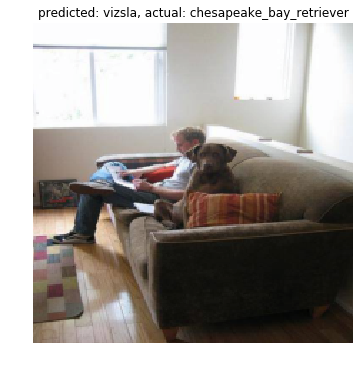

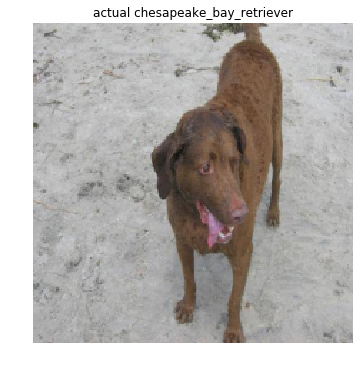

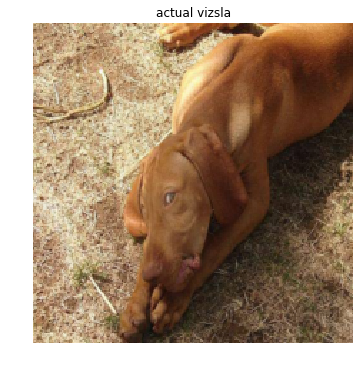

 --------------------
|       NEXT         |
 --------------------


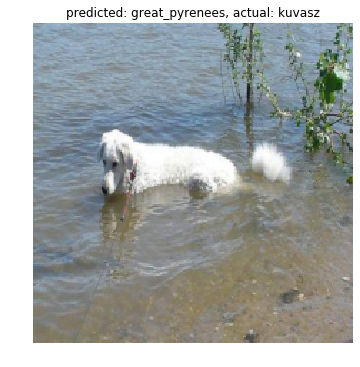

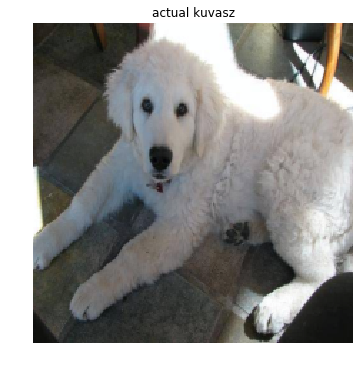

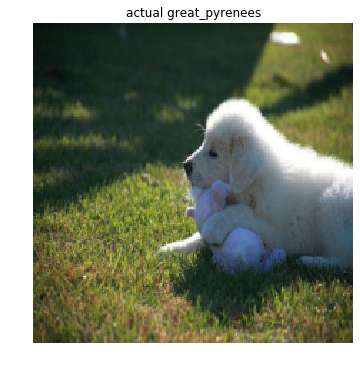

 --------------------
|       NEXT         |
 --------------------


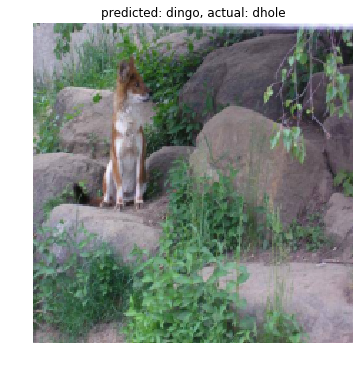

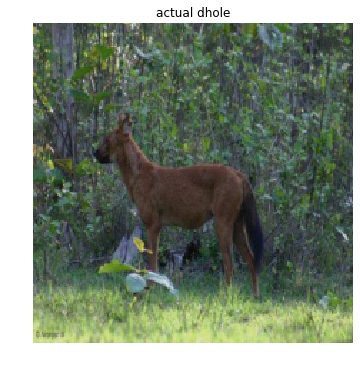

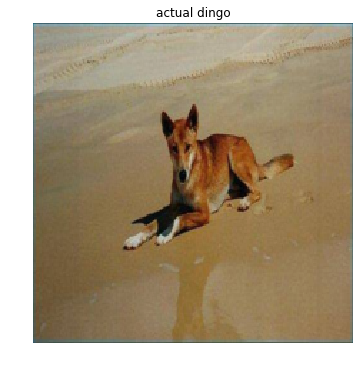

 --------------------
|       NEXT         |
 --------------------


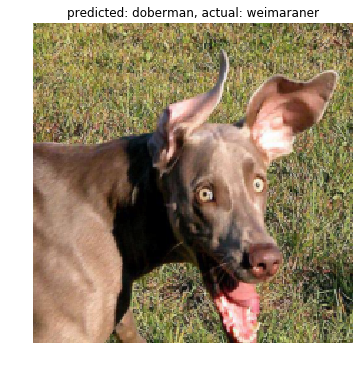

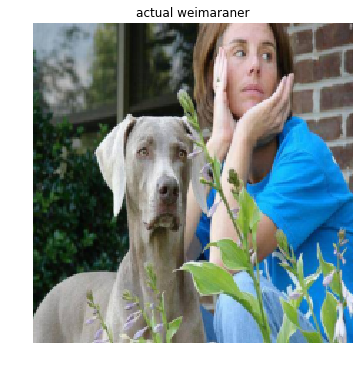

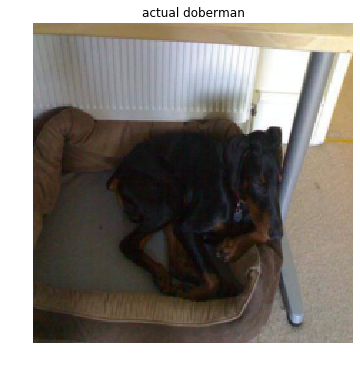

 --------------------
|       NEXT         |
 --------------------


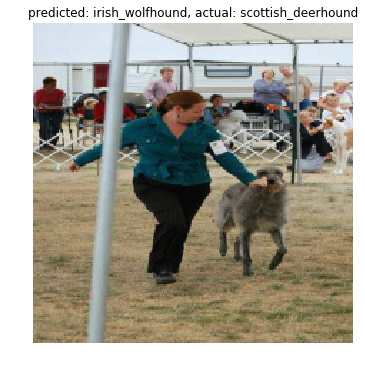

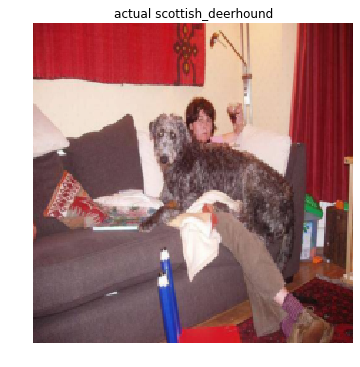

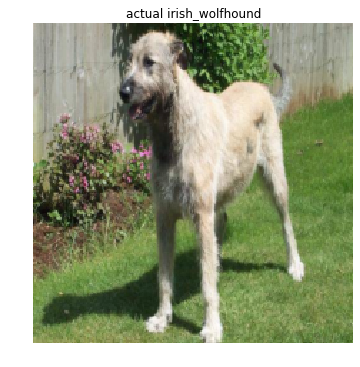

 --------------------
|       NEXT         |
 --------------------


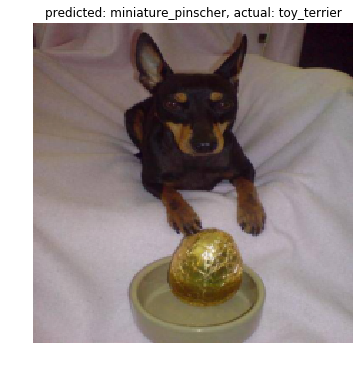

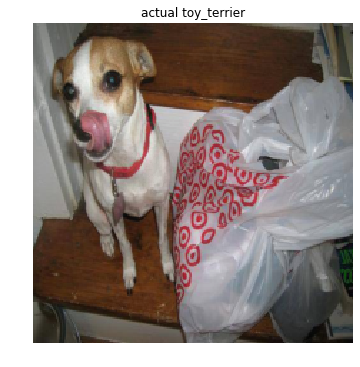

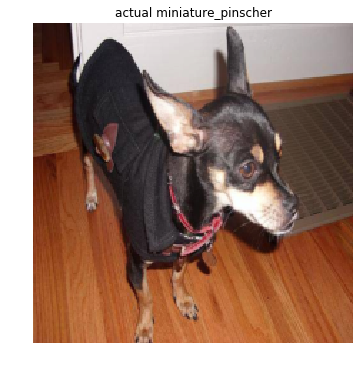

In [45]:
visualize_classifications(resnet_model, correct=False)
# visualize_classifications(resnet_model, correct=True)

#### resnet152 mistakes

Even the inaccurate resnet seems to continue the trend.

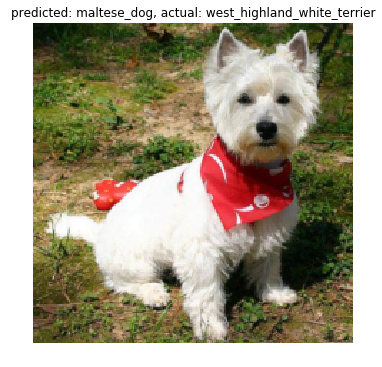

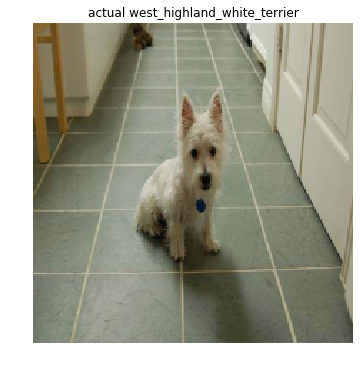

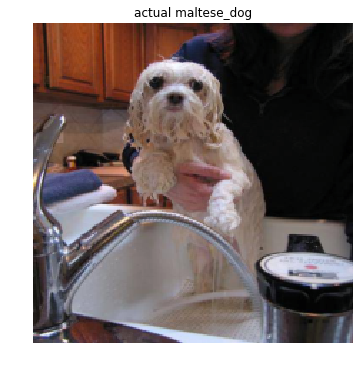

 --------------------
|       NEXT         |
 --------------------


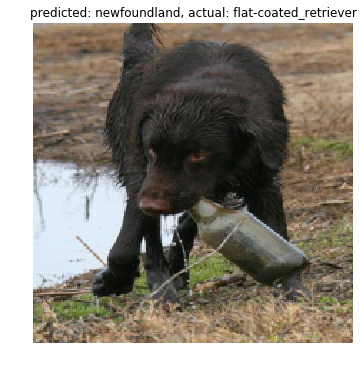

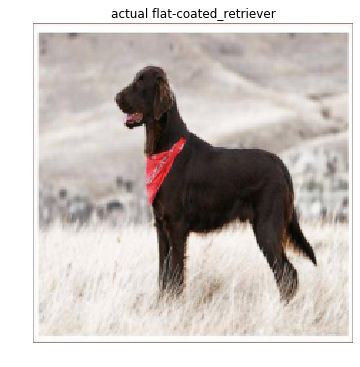

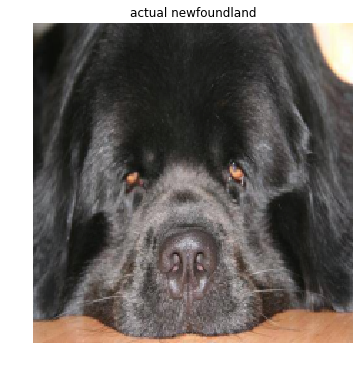

 --------------------
|       NEXT         |
 --------------------


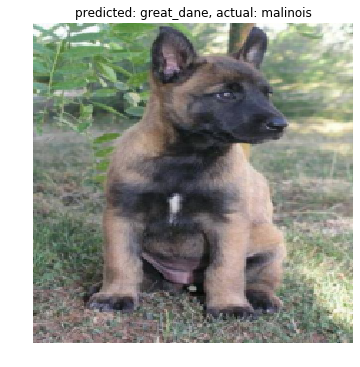

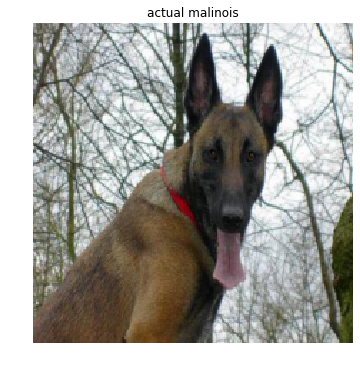

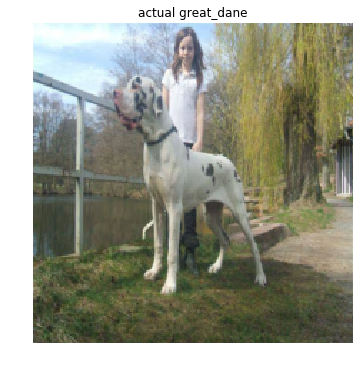

 --------------------
|       NEXT         |
 --------------------


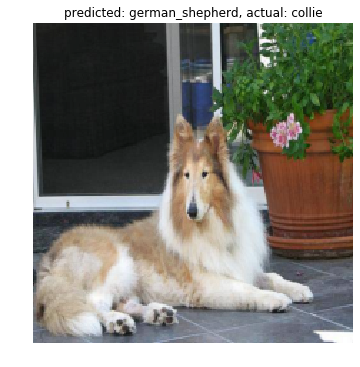

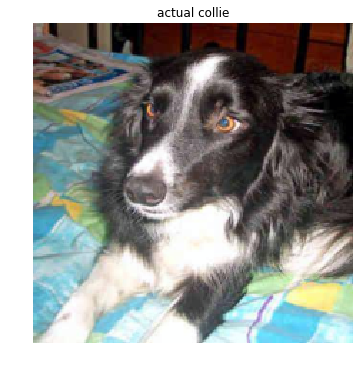

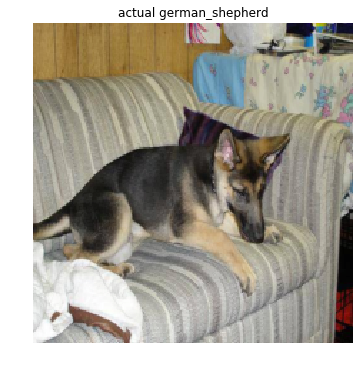

 --------------------
|       NEXT         |
 --------------------


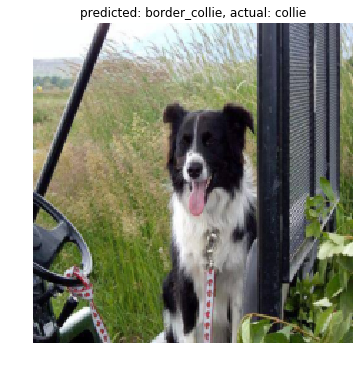

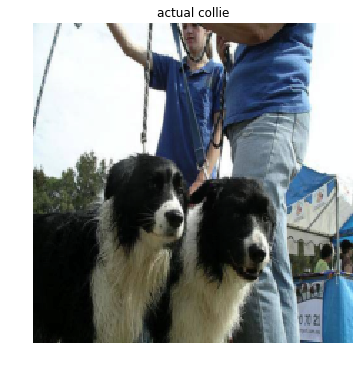

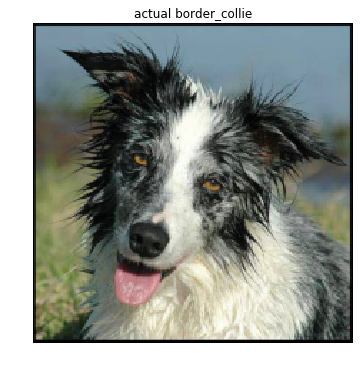

 --------------------
|       NEXT         |
 --------------------


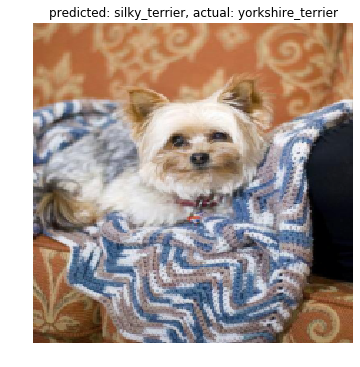

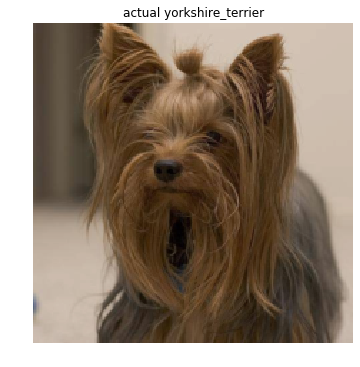

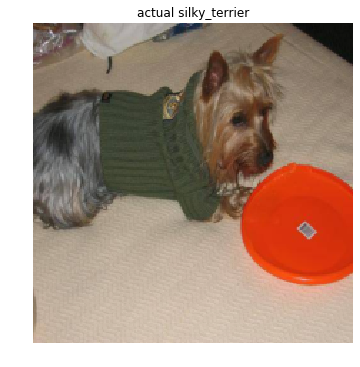

In [46]:
visualize_classifications(resnet152_model, correct=False)
# visualize_classifications(resnet152_model, correct=True)

### Classification mistakes roundup

To summarize: the models did a good job identifying breeds. I dont expect humans to do much better in identifying breeds. Most of the incorrect classifications were due similar breeds and bad image quality. Regardless, the models performed quite well. The worst models accuracy of 68% is still pretty good considering there are 120 breeds to classify.

### Testdata visualization

Lets try the test data by seeing the models predictions. Unfortunately we cannot know what the actual breed is in this case, but It'll be interesting to see the results.

#### Predict breed

This function opens image, predicts its breed and finally shows the image, along with the prediction confidence levels. Shows how confident the model was on the result, and what other classes did it 'believe' the dog was.

In [47]:
def predict_breed(image_path, model):
    image = Image.open(image_path)

    image_tensor = data_transforms['test'](image).float().unsqueeze_(0).to(device)

    input = Variable(image_tensor)
    output = model(input)
    softmax = nn.Softmax(dim=1)
    top_preds = torch.topk(softmax(output), 3)
    pred_breeds = [class_names[i] for i in top_preds[1][0]]
    confidence = top_preds[0][0]

    _, ax = plt.subplots()
    _ = ax.imshow(image)
    plt.axis('off')
    plt.show()
    predictions = ''
    for breed, conf in zip(pred_breeds, confidence):
        if conf > 0.005:
            predictions += f'  - {breed} ({(conf*100):.0f}%)\n'
    print(f'Predicted Breed (confidence):\n{predictions}')

First the best of my models, densenet. It seems to make good classifications. The final image however only has confidence of 34%, caused most likely by the intruding human. Even the dog in question does not appear amused of the situation, and is clearly not a whippet.

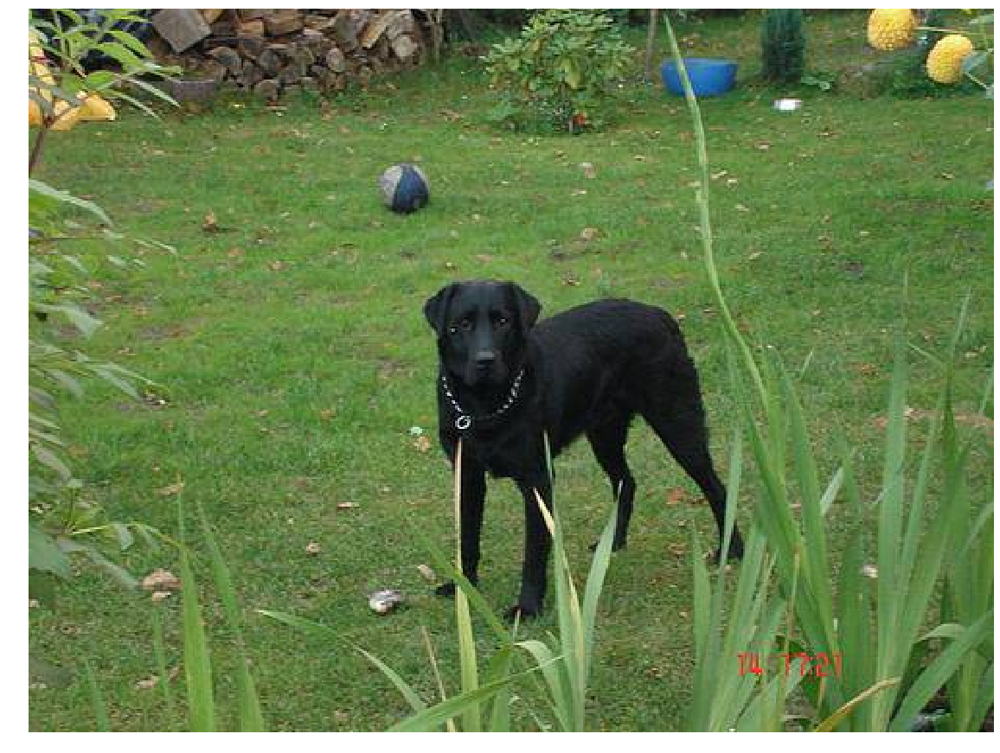

Predicted Breed (confidence):
  - flat-coated_retriever (93%)
  - weimaraner (2%)
  - labrador_retriever (1%)



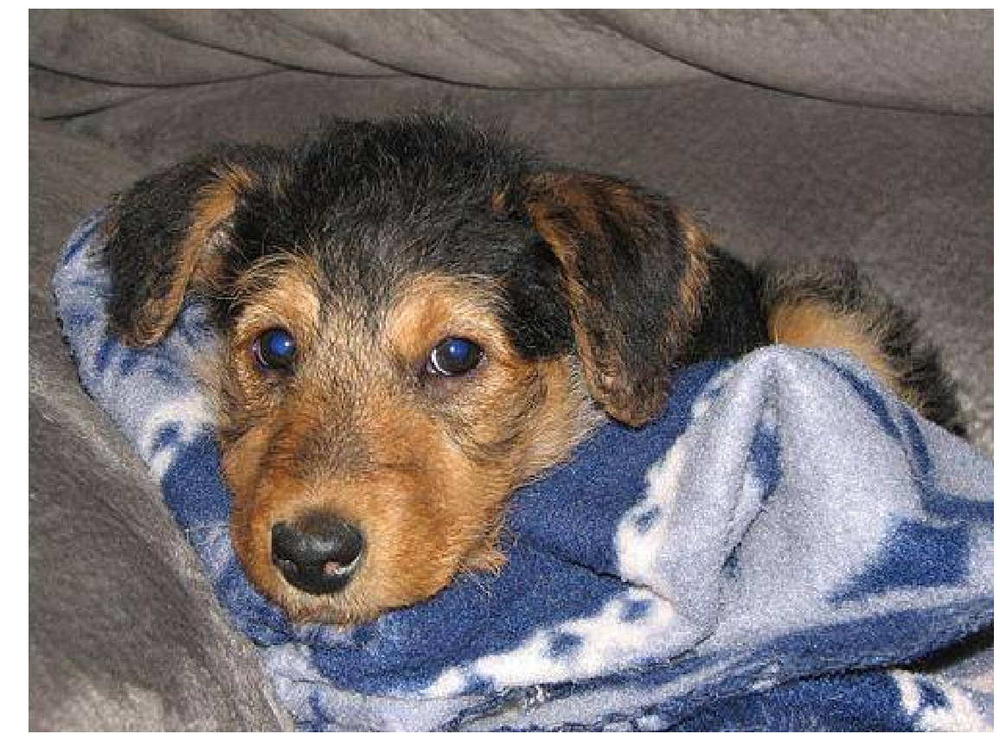

Predicted Breed (confidence):
  - airedale (98%)
  - australian_terrier (1%)



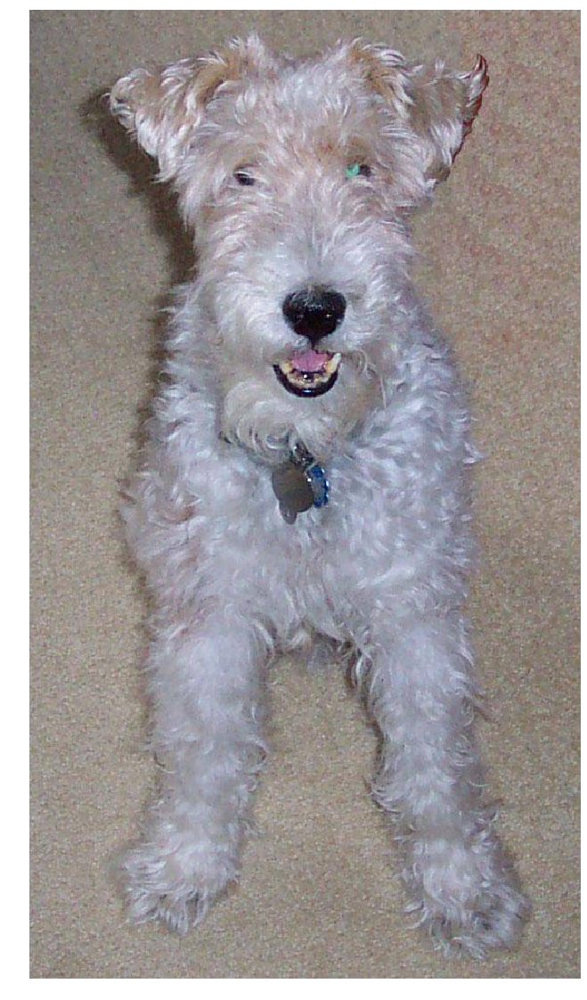

Predicted Breed (confidence):
  - wire-haired_fox_terrier (100%)



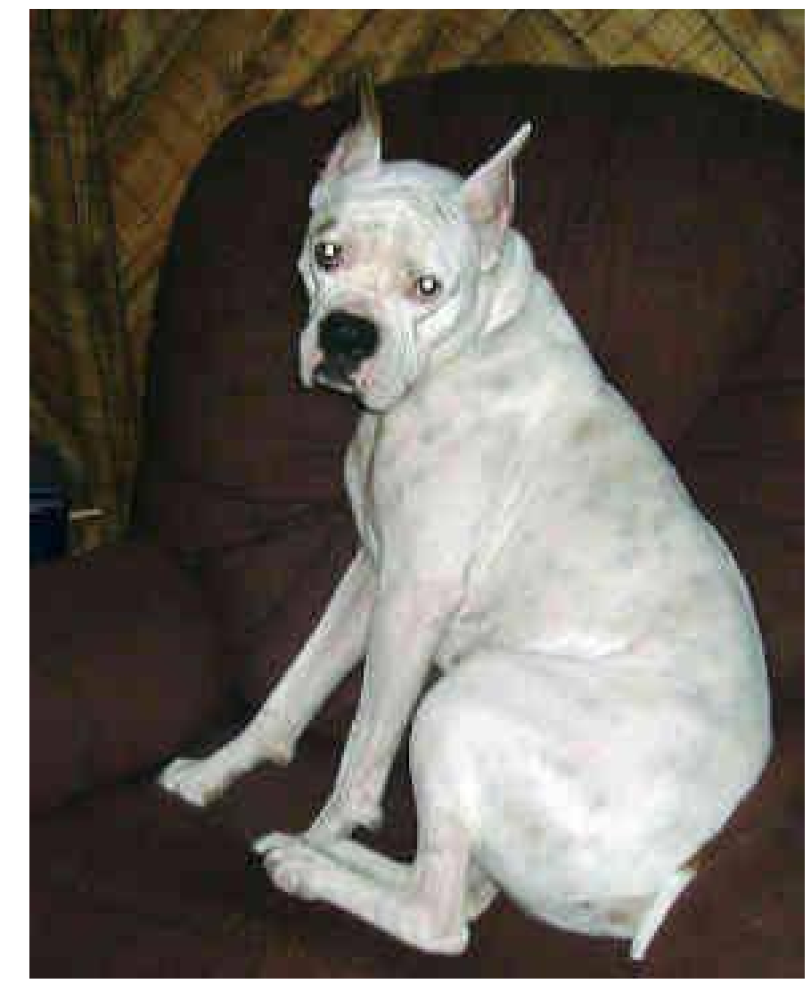

Predicted Breed (confidence):
  - boxer (99%)



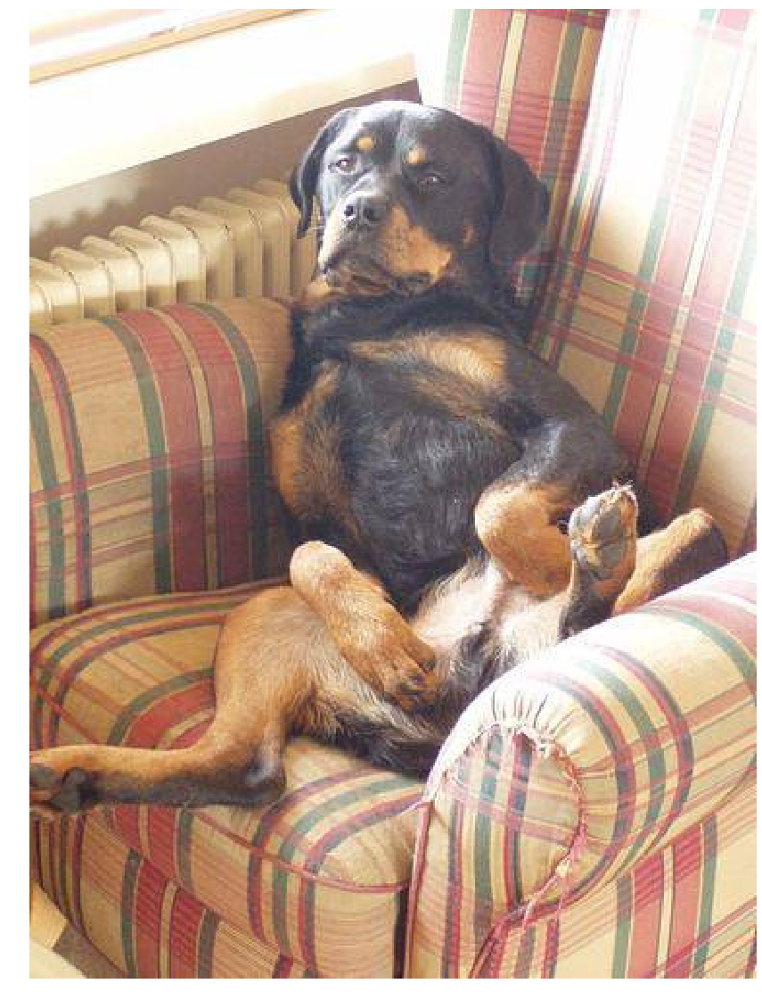

Predicted Breed (confidence):
  - rottweiler (100%)



In [49]:
for i in range(5):
    img_path=random.choice(os.listdir('data/test'))
    predict_breed('data/test/' + img_path, densenet_model)

Now trying vgg, the results are not anything special

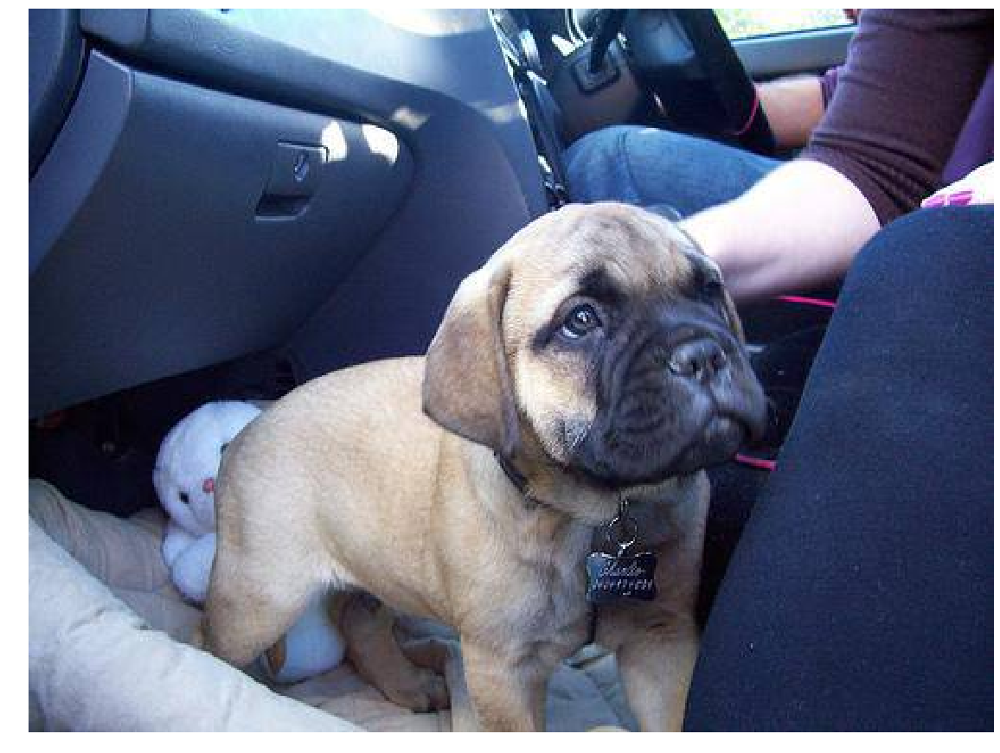

Predicted Breed (confidence):
  - pug (75%)
  - bull_mastiff (24%)



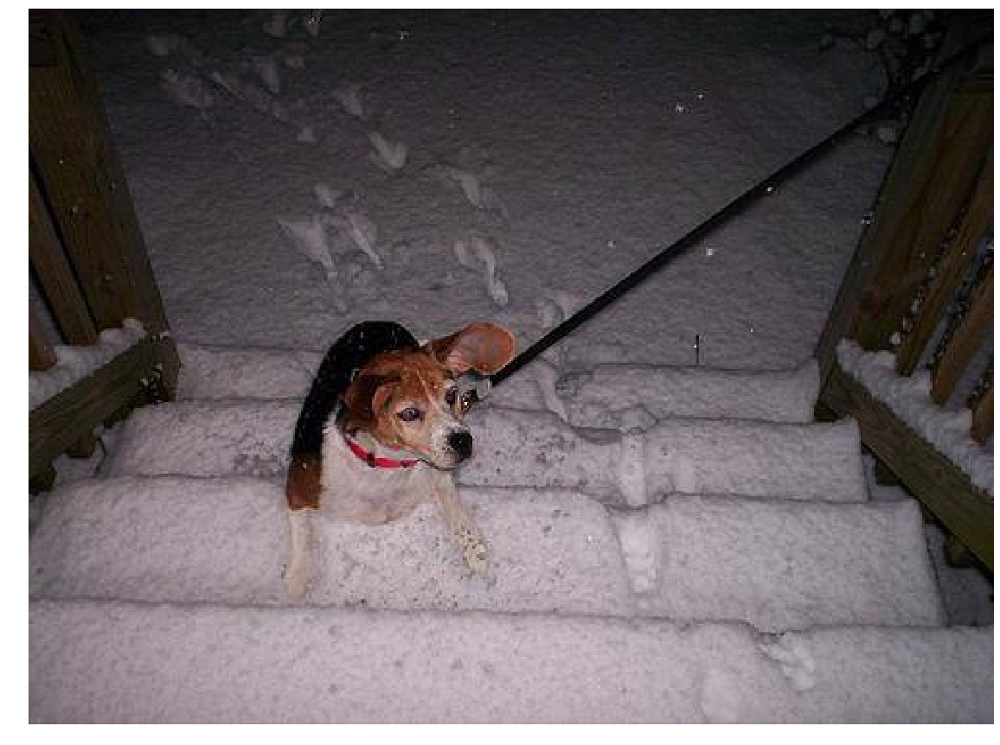

Predicted Breed (confidence):
  - beagle (86%)
  - basset (11%)
  - toy_terrier (1%)



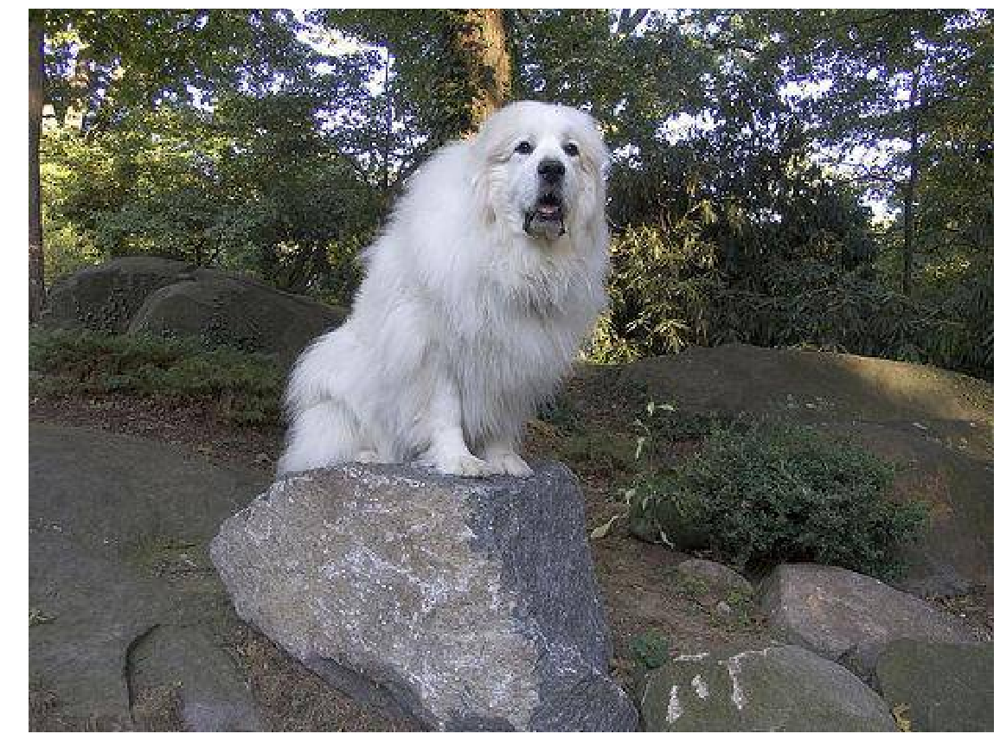

Predicted Breed (confidence):
  - great_pyrenees (100%)



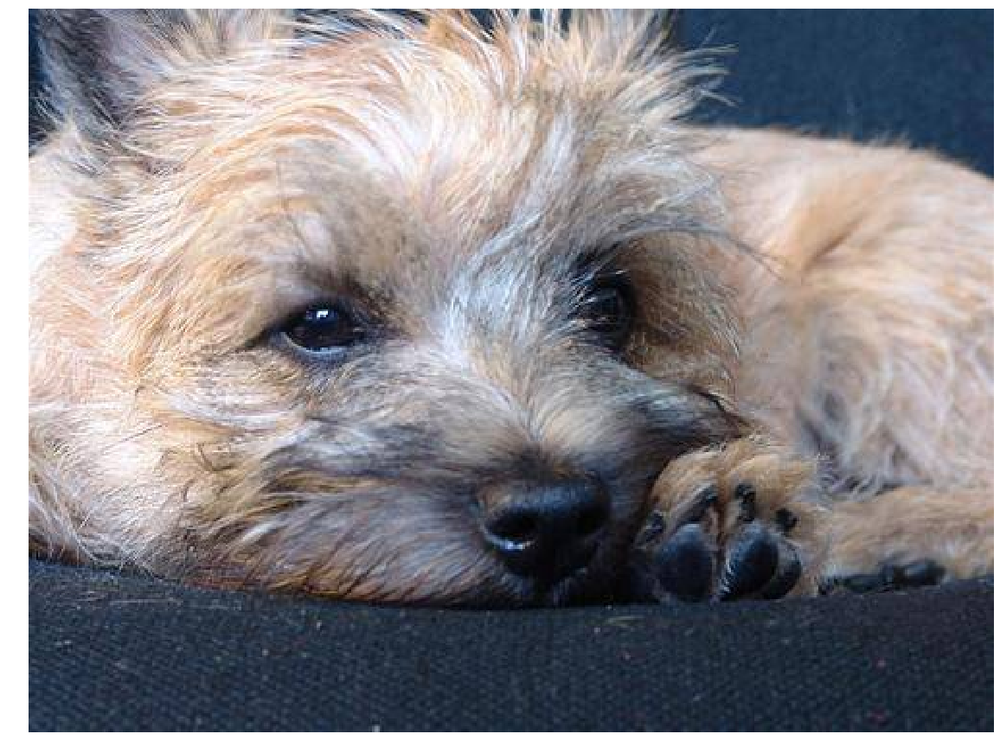

Predicted Breed (confidence):
  - cairn (100%)



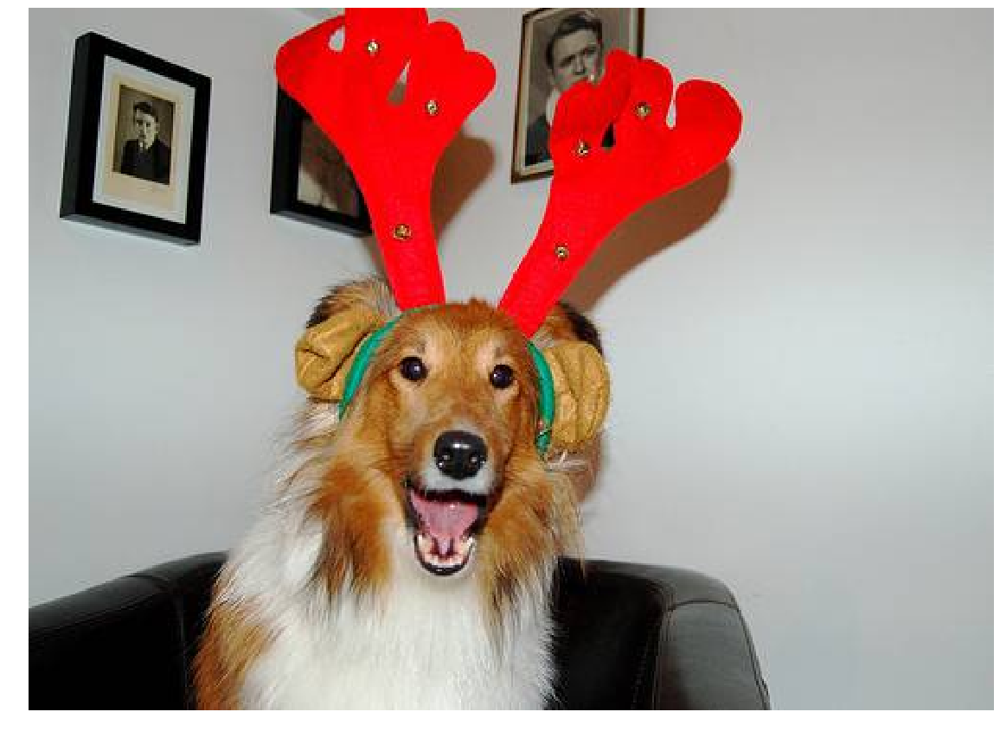

Predicted Breed (confidence):
  - shetland_sheepdog (60%)
  - collie (39%)



In [50]:
for i in range(5):
    img_path=random.choice(os.listdir('data/test'))
    predict_breed('data/test/' + img_path, vgg_model)

Then the worst...

Resnet152 does not seem to be very confident in some of its predictions.

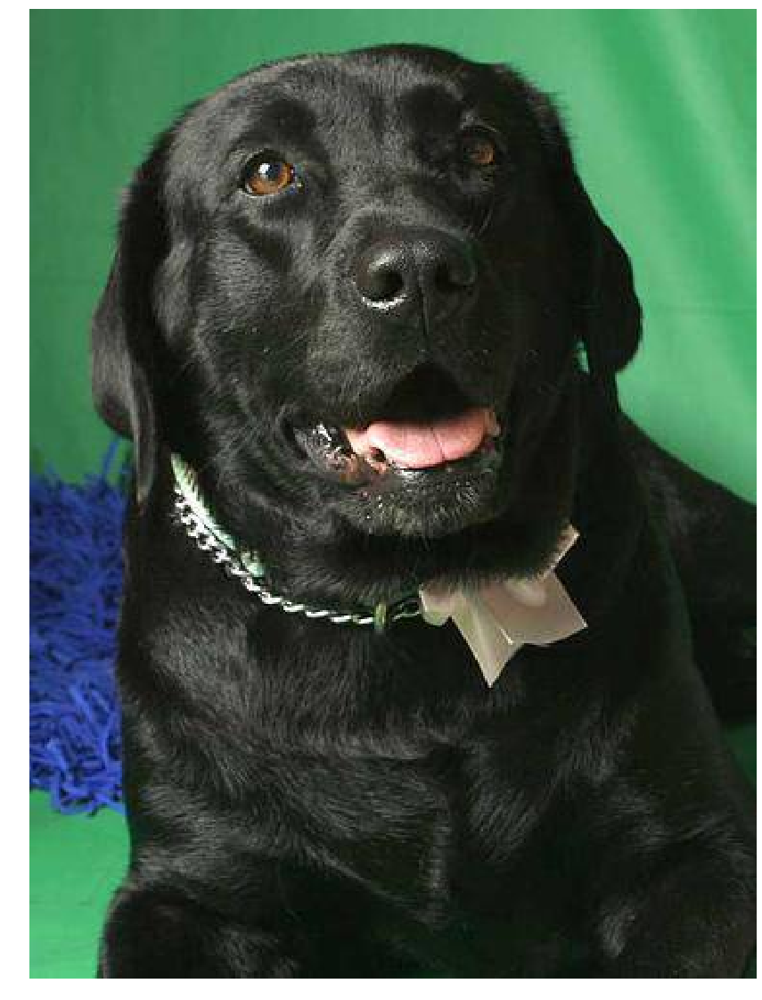

Predicted Breed (confidence):
  - staffordshire_bullterrier (3%)
  - giant_schnauzer (3%)
  - rottweiler (2%)



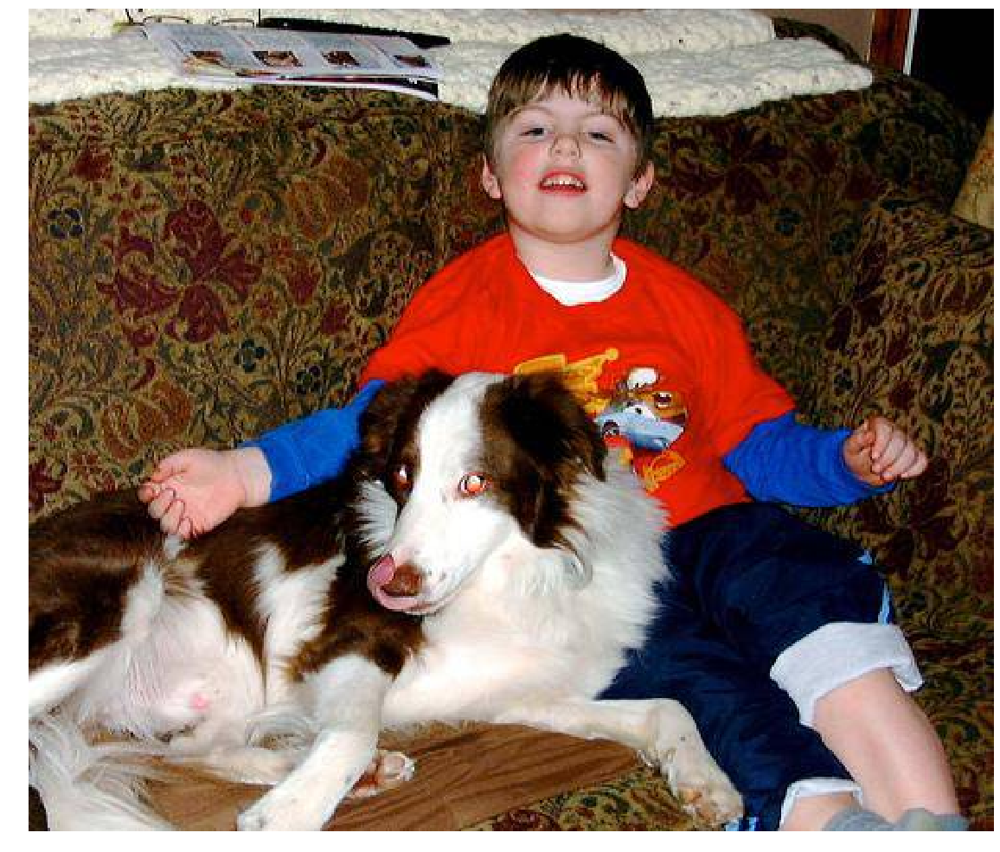

Predicted Breed (confidence):
  - border_collie (41%)
  - borzoi (29%)
  - ibizan_hound (1%)



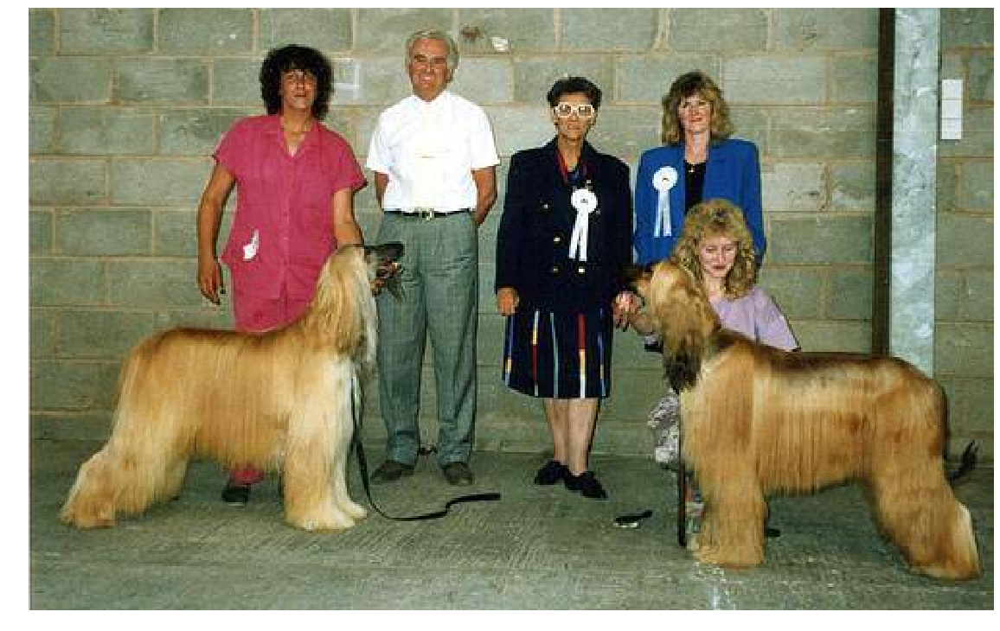

Predicted Breed (confidence):
  - afghan_hound (100%)



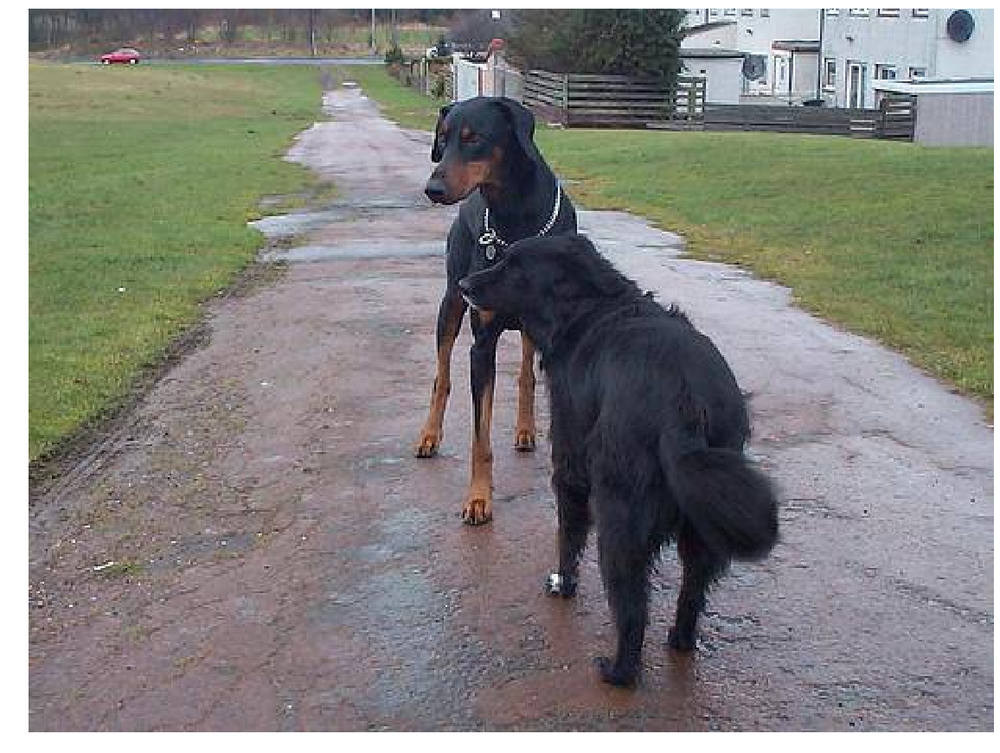

Predicted Breed (confidence):
  - gordon_setter (21%)
  - rottweiler (4%)
  - saluki (2%)



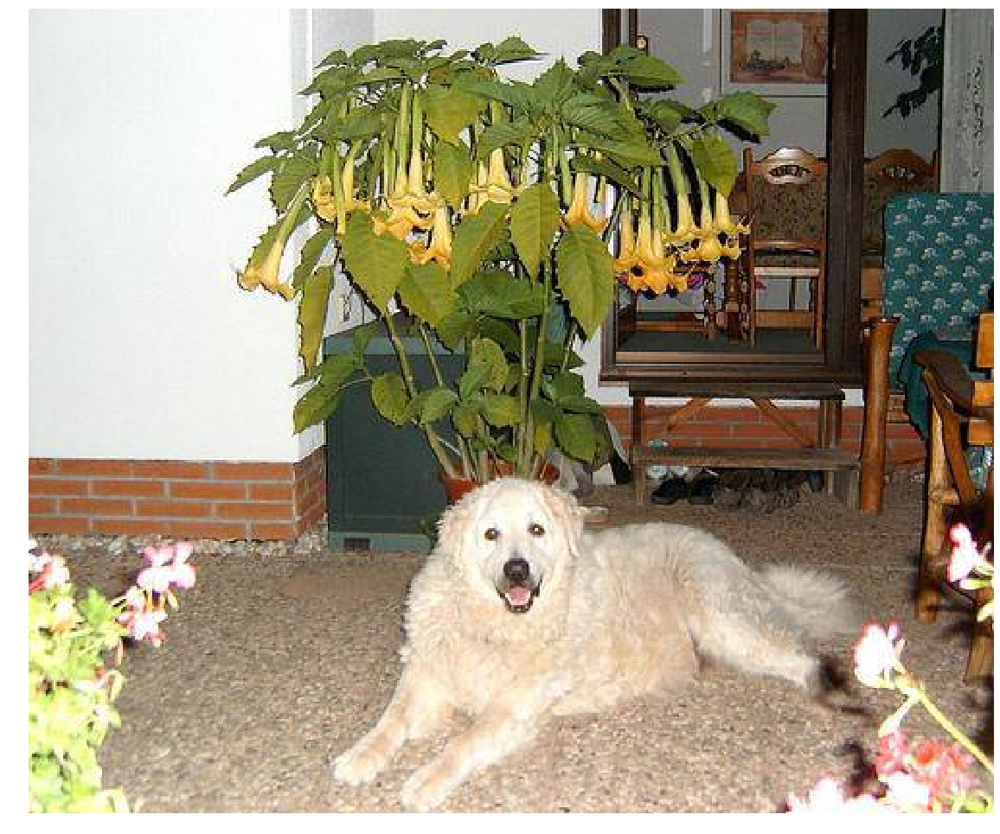

Predicted Breed (confidence):
  - great_pyrenees (38%)
  - soft-coated_wheaten_terrier (3%)
  - samoyed (2%)



In [50]:
for i in range(5):
    img_path=random.choice(os.listdir('data/test'))
    predict_breed('data/test/' + img_path, resnet152_model)

## Final results

It is clear that neural networks are excellent at classifying even very similar objects from images. I did not expect the results to be this good with the pretrained networks, but the accuracy of the resulting models blew my mind.

The results of resnet152 were however most disappointing. The poor accuracy was nowhere near the level of the rest, more simple networks. Still, it is possible the result would increase with more epochs and training. It is likey the additional layers would require much more adjustment than the other models, which only had 1 layer self-trained

In the visualizations, it appears that most of the misclassifications and lack of confidence is caused by bad images, or similar breeds. Still, the networks marched on and brought home good results.